In [30]:
import pandas as pd
import numpy as np

from skopt.space import Real, Integer
from keras.models import Model
from keras.layers import Input, Dense, Dropout
from keras.optimizers import Adam

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args

from scipy.stats import qmc  
from GPyOpt.methods import BayesianOptimization

from sklearn.metrics import mean_squared_error, r2_score

Neural Network Model for Hyper Parameter Tuning

In [31]:
def benchmark(X, Y):
    return (X * np.sin(X)) + (Y * np.sin(Y))


In [ ]:
# Random seed
np.random.seed(1)

# Number of observations to train the Neural Network on before starting the active learning loop
pretrain_n = 10

# Standard deviation of simulated response
sim_stdev = 0.02

# Number of bayesian optimization iterations for calibrating simulation model
max_bo_iter = 150

# Random seed
r = np.random.default_rng(seed=2)

In [33]:
ran_err = lambda n, x: r.normal(0, x, n)
sim_err = lambda x, y, a, b: 0.1 * (a - 4) * x + 0.05 * (b + 3) * y**2 + 0.03 * x * y + r.normal(0, sim_stdev)

In [ ]:
def initialize_df(n):
    # Generate n random data points for 2 inputs (X, Y) within specified bounds
    X = np.random.uniform(-5, 18, n)
    Y = np.random.uniform(-5, 18, n)

    # Calculate the outputs using a predefined benchmark function
    output1 = benchmark(X, Y) + ran_err(n, 0.05)

    # Generate Initial Dataset of Physical Experiments
    df = pd.DataFrame({
        'x': X,
        'y': Y,
        'z': output1,
    })
    return df


In [35]:
sim_eval = lambda x, y, a, b: benchmark(x, y) + sim_err(x, y, a, b)

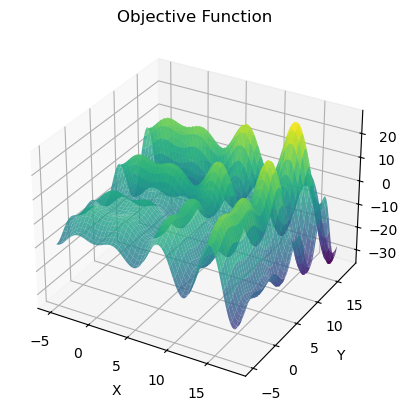

In [36]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create the grid of input values
x_range = np.linspace(-5, 18, 100)
y_range = np.linspace(-5, 18, 100)
x_grid, y_grid = np.meshgrid(x_range, y_range)

# Evaluate function on grid
z_grid = benchmark(x_grid, y_grid)

# Create the plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x_grid, y_grid, z_grid, cmap='viridis', alpha=0.8)

# Customize the plot
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_title('Objective Function')

# Show the plot
plt.show()

In [ ]:
# Defining the Neural Network Model
def NN_model(num_layers, num_units, learning_rate, dropout_rate):
    inputs = Input(shape=(2,))
    x = Dense(num_units, activation='relu', kernel_regularizer='l2')(inputs)
    for _ in range(num_layers - 1):
        x = Dense(num_units, activation='relu', kernel_regularizer='l2')(x)
        x = Dropout(dropout_rate)(x)
    outputs = Dense(1, activation='linear')(x)
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer=Adam(learning_rate=learning_rate), loss='mean_squared_error')
    return model

# Function for MC Dropout predictions
def mc_dropout_predictions(model, X, num_samples=50):
    predictions = np.zeros((num_samples, X.shape[0]))
    for i in range(num_samples):
        predictions[i, :] = model(X, training=True).numpy().flatten()
    prediction_mean = predictions.mean(axis=0)
    prediction_std = predictions.std(axis=0)
    return prediction_mean, prediction_std


In [38]:
# Define the known global maxima for the Himmelblau's function
global_maxima_points = [
    {"X": 14.28, "Y":  14.28, "Z": benchmark(14.28,  14.28)},
]

# Create a DataFrame for the global maxima
global_maxima_df = pd.DataFrame(global_maxima_points)
global_maxima_df

,X,Y,Z
0,14.28,14.28,28.269165


In [39]:
rmse_list = []
r2_list = []
iteration_list = []

In [ ]:
def perform_iteration(df, iteration, rmse_list, r2_list, iteration_list, exp_n):

    def sim_all(x):
        df["a"] = x[0,0]
        df["b"] = x[0,1]
        df["sim_z"] = sim_eval(df["x"], df["y"], df["a"], df["b"])
        df["diff"] = df["z"] - df["sim_z"]
        return (df["diff"]**2).sum()

    bo_domain = [{'name': 'a', 'type': 'continuous', 'domain': (-10,10)},
            {'name': 'b', 'type': 'continuous', 'domain': (-10,10)}]

    # Calibrate the sim model using physical tests so far, update df["a"] and df["b"] with calibrated parameters
    bo = BayesianOptimization(f=sim_all, domain=bo_domain, acquisition_type='EI')
    bo.run_optimization(max_iter=max_bo_iter)
    df["a"] = bo.x_opt[0]
    df["b"] = bo.x_opt[1]
    print(bo.x_opt)

    # Create the grid of input values
    x_range = np.linspace(-5, 18, 100)
    y_range = np.linspace(-5, 18, 100)
    x_grid, y_grid = np.meshgrid(x_range, y_range)
    sim_z_grid = sim_eval(x_grid, y_grid, bo.x_opt[0], bo.x_opt[1])

    # Create the plot
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(x_grid, y_grid, sim_z_grid, cmap='viridis', alpha=0.8)

    # Customize the plot
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('True Function with Simulation Calibrated Errors')

    # Show the plot
    plt.show()

    # Generate points using Latin Hypercube Sampling (LHS)
    n_samples = 100
    lhs= qmc.LatinHypercube(d=2, optimization="random-cd")
    lhs_samples = lhs.random(n=n_samples)
    bounds = np.array([[-5, 18], [-5, 18]])  # Bounds for Design Space

    scaled_samples = qmc.scale(lhs_samples, bounds[:, 0], bounds[:, 1])

    selected_points_df = pd.DataFrame(scaled_samples, columns=['x', 'y'])
    selected_points_df['sim_z'] = sim_eval(selected_points_df['x'], selected_points_df['y'], bo.x_opt[0], bo.x_opt[1])

    sim_df = df[["x", "y", "sim_z"]]
    sim_df = pd.concat([sim_df, selected_points_df], axis=0, ignore_index=True)

    # Train the model with the given hyperparameters on the entire dataset
    best_model = NN_model(
        num_layers=6,
        num_units=300,
        learning_rate=0.0007,
        dropout_rate=0.5
    )

    # Standardize the Dataset of Simulation Responses
    scaler= StandardScaler().fit(sim_df[['x', 'y']])
    X_scaled = scaler.transform(sim_df[['x', 'y']])

    # Train the best model on the combined standardized dataset
    best_model.fit(X_scaled, sim_df[['sim_z']], epochs=500, batch_size=150, verbose=1)

    # Create a meshgrid and combine into a single array
    xy_grid = np.c_[x_grid.ravel(), y_grid.ravel()]

    # Perform MC Dropout predictions on the entire grid
    xy_grid_scaled = scaler.transform(xy_grid)
    pred_mean, pred_std = mc_dropout_predictions(best_model, xy_grid_scaled)

    # Ploting mean predictions and confidence intervals
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Reshaping predictions back to grid shape
    pred_mean_grid = pred_mean.reshape(x_grid.shape)
    pred_upper_grid = (pred_mean + (1.96 * pred_std)).reshape(x_grid.shape)
    pred_lower_grid = (pred_mean - (1.96 * pred_std)).reshape(x_grid.shape)

    mean_surface = ax.plot_surface(x_grid, y_grid, pred_mean_grid, color='blue', alpha=0.5, label='Mean Prediction')
    upper_surface = ax.plot_surface(x_grid, y_grid, pred_upper_grid, color='red', alpha=0.3, label='Upper Bound (95% CI)')
    lower_surface = ax.plot_surface(x_grid, y_grid, pred_lower_grid, color='green', alpha=0.3, label='Lower Bound (95% CI)')

    # Customize the plot
    ax.set_title('Neural Network of Simulated Response with Confidence Intervals')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Output')

    # Legend
    legend_elements = [mean_surface, upper_surface, lower_surface]
    fig.legend(handles=legend_elements, loc='upper left', bbox_to_anchor=(0.1, 0.9))

    # Show the plot
    plt.show()
    
    x_range = [(-5, 18)]
    y_range = [(-5, 18)]
    def p_nn(xy):
        xy = np.array(xy).reshape(1, -1)  # Ensure correct shape (1,2)
        xy_scaled = scaler.transform(xy)
        pred_mean, pred_std = mc_dropout_predictions(best_model, xy_scaled)
        # Check if the point is inside the valid domain
        if (x_range[0][0] <= xy[0, 0] <= x_range[0][1] and 
                y_range[0][0] <= xy[0, 1] <= y_range[0][1]):
            
            probability = max(pred_mean + 1.96 * pred_std - sim_df["sim_z"].median(), 1e-6)  # Avoid zero
            return probability
        else:
            return 1e-10  # Keep very small but nonzero probability for out-of-bounds case


    def metropolis_step(xy, sig):
        prop_xy = xy + np.random.normal(0, sig, size=xy.shape)  # Generate a candidate

        # Ensure proposed point is inside the valid bounds
        if not (x_range[0][0] <= prop_xy[0, 0] <= x_range[0][1] and 
                y_range[0][0] <= prop_xy[0, 1] <= y_range[0][1]):
            return xy  # Reject out-of-bounds proposals

        u = np.random.uniform(0, 1)
        if u < min(1.0, p_nn(prop_xy) / p_nn(xy)):
            return prop_xy  # Accept move
        else:
            return xy  # Stay at current point


    def mh_sampler(sig, sample_size, burn_in, lag):
        # Start at the point with the largest simulated response
        max_idx = np.argmax(sim_df["sim_z"])
        x_init = sim_df["x"].iloc[max_idx]
        y_init = sim_df["y"].iloc[max_idx]
        xy = np.array([[x_init, y_init]])

        # Burn-in phase
        for i in range(burn_in):
            xy = metropolis_step(xy, sig)

        # Sampling phase
        output = xy
        for i in range(sample_size - 1):
            for j in range(lag):
                xy = metropolis_step(xy, sig)
            output = np.vstack((output, xy))  # Stack valid samples

        return output  # Returns an array of shape (sample_size, 2)

    # Find point with highest NN predicted mean response
    flat_pred_mean = pred_mean.flatten()
    max_idx = np.argmax(flat_pred_mean)

    x_max = xy_grid[max_idx, 0]
    y_max = xy_grid[max_idx, 1]
    max_point = np.array([[x_max, y_max]])


    X_mh = mh_sampler(sig=5, sample_size=exp_n - 1, burn_in=50, lag=20)

    X_all = np.vstack([max_point, X_mh])

    physical_test_points = pd.DataFrame(X_all, columns=["x", "y"])

    # Generate predictions for the heatmap
    pred_mean_grid = pred_mean.reshape(x_grid.shape)

    # Plot the heatmap
    plt.figure(figsize=(10, 8))
    heatmap = plt.contourf(x_grid, y_grid, pred_mean_grid, cmap='viridis', levels=50)
    plt.colorbar(heatmap, label="Neural Network Response")

    # Overlay sampled points
    plt.scatter(sim_df['x'], sim_df['y'], color='white', edgecolor='black', label='Simulation Sampled Points')
    plt.scatter(physical_test_points['x'], physical_test_points['y'], color='purple', edgecolor='black', label='Next Physical Test Points')

    # Customize the plot
    plt.title("Heatmap of Neural Network Response")
    plt.xlabel("X1")
    plt.ylabel("X2")
    plt.legend()
    plt.show()

    # Add validated data points to original data frame
    physical_test_points["z"] = benchmark(physical_test_points['x'], physical_test_points['y']) + ran_err(exp_n, 0.05)
    physical_test_points["a"] = bo.x_opt[0]
    physical_test_points["b"] = bo.x_opt[1]
    physical_test_points["sim_z"] = sim_eval(physical_test_points["x"], physical_test_points["y"], physical_test_points["a"], physical_test_points["b"])
    physical_test_points["diff"] = physical_test_points["z"] - physical_test_points["sim_z"]

    # Heatmap of Simulated Points 
    fig, ax = plt.subplots(figsize=(10, 8))

    # Plot the heatmap for sim_z_grid
    heatmap = ax.contourf(x_grid, y_grid, sim_z_grid, levels=100, cmap='viridis', alpha=0.8)

    # Overlay scatter points for sampling points
    ax.scatter(df["x"], df["y"], color='blue', marker='o', label='Previous Sampled Points')
    ax.scatter(sim_df["x"], sim_df["y"], edgecolor='black', facecolors='none', marker='o', label='Sampled Simulation Points')
    ax.scatter(physical_test_points["x"], physical_test_points["y"], color='purple', marker='o', label='Next Physical Test Points')
    for i, row in physical_test_points.iterrows():
        ax.text(row["x"], row["y"], f"({row['x']:.1f}, {row['y']:.1f})", 
                fontsize=8, ha='center', va='bottom', color='black', 
                bbox=dict(boxstyle='round,pad=0.2', fc='white', alpha=0.5))
    # Overlay scatter points for global maxima
    ax.scatter(global_maxima_df['X'], global_maxima_df['Y'], color='red', marker='o', label='Global Maximum Point')

    # Customize the plot
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('True Function with Simulation Calibrated Errors (Heatmap)')
    ax.legend()

    # Add a color bar
    cbar = plt.colorbar(heatmap, ax=ax)
    cbar.set_label('Function Value (Z)')

    # Show the plot
    plt.show()

    # Add points to original dataframe
    df = pd.concat([df, physical_test_points], axis=0, ignore_index=True)

    # Track Physical Test Points
    print(f"Selected {len(physical_test_points)} new test points. Median diff: {physical_test_points['diff'].median():.4f}")

    # Compute RMSE and R² between true and simulated values
    rmse = mean_squared_error(df["z"], df["sim_z"], squared=False)
    r2 = r2_score(df["z"], df["sim_z"])

    # Log metrics
    rmse_list.append(rmse)
    r2_list.append(r2)
    iteration_list.append(iteration)

    print(f"[Iteration {iteration}] RMSE: {rmse:.4f}, R²: {r2:.4f}")
    

    return df

In [41]:
experiment_counts = [5, 10, 15, 20, 25]  # Number of physical experiments to test
n_iterations_per_run = 7  # How many iterations to run per pipeline execution

In [42]:
results = []

def log_metrics(exp_count, iteration, rmse, r2, best_z):
    results.append({
        "Physical_Experiment_Count": exp_count,
        "Iteration": iteration,
        "RMSE": rmse,
        "R2": r2,
        "Best_Z": best_z
    })


=== Running with 5 physical experiments ===
[ 4.07913542 -2.86110628]


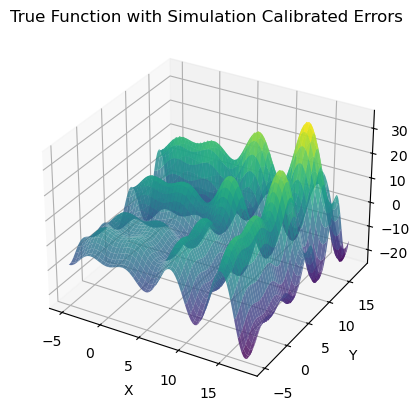

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 105.9251
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 106.3834
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 105.7887
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 105.9539
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 106.2718
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 106.1300
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 105.7389
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 105.4872
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 105.7095
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 105.7115
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 105.2836
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 104.5348
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 105.1480
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 105.3246
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 

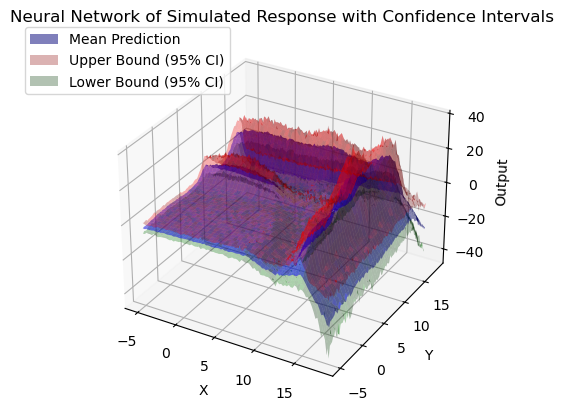

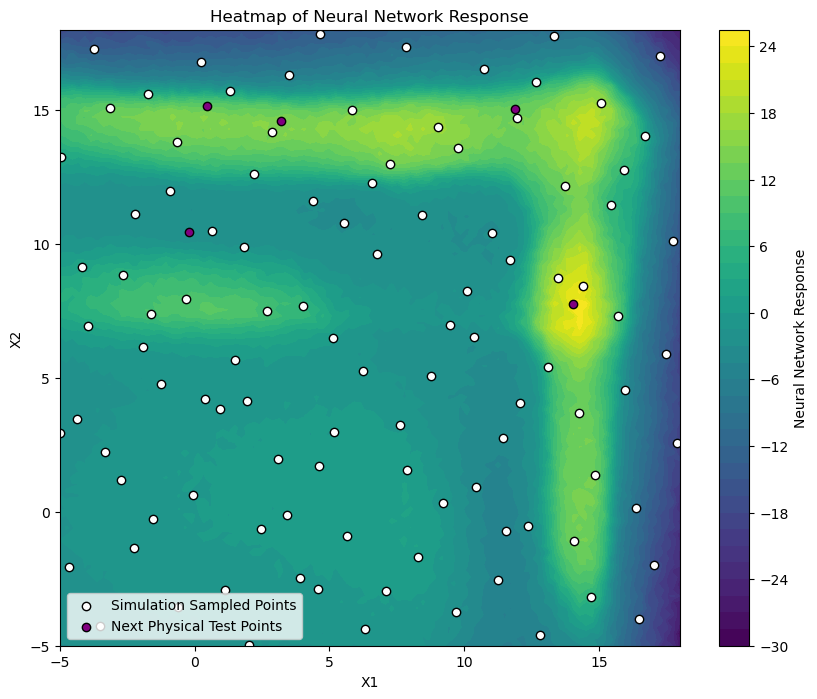

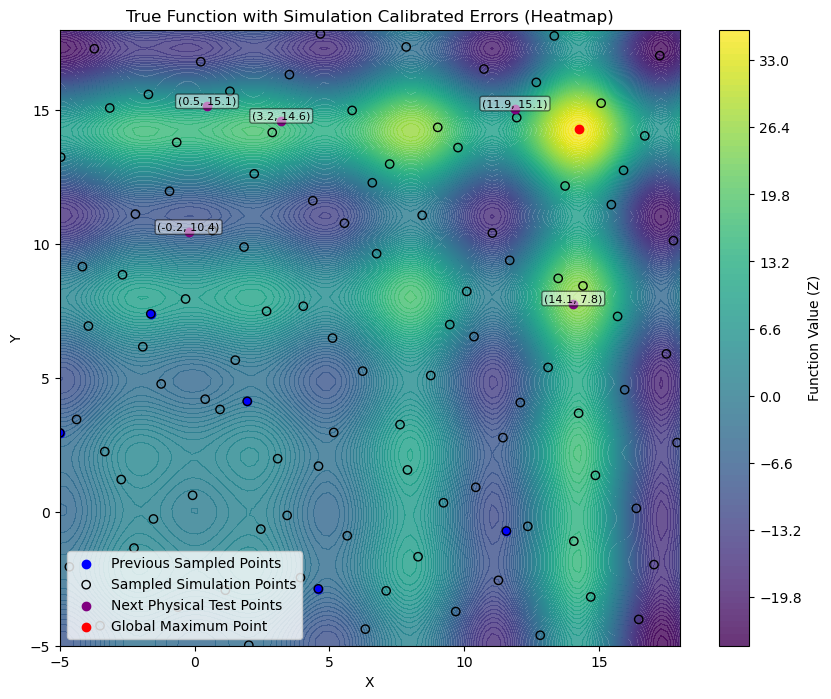

Selected 5 new test points. Median diff: -2.8947
[Iteration 0] RMSE: 2.7985, R²: 0.9149
[ 2.48769901 -3.14265006]


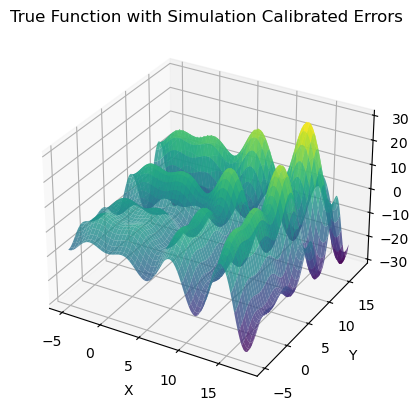

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 117.5335
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 116.7997
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 116.6124
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 117.0151
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 116.5620
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 115.7969
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 115.4688
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 115.5604
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 114.6114
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 114.4839
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 114.1530
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 113.1034
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 114.1335
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 112.7902
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 

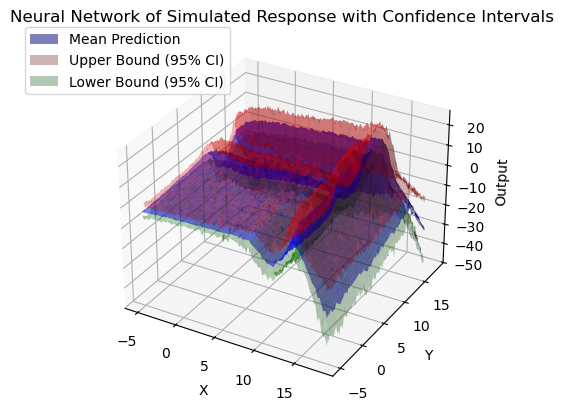

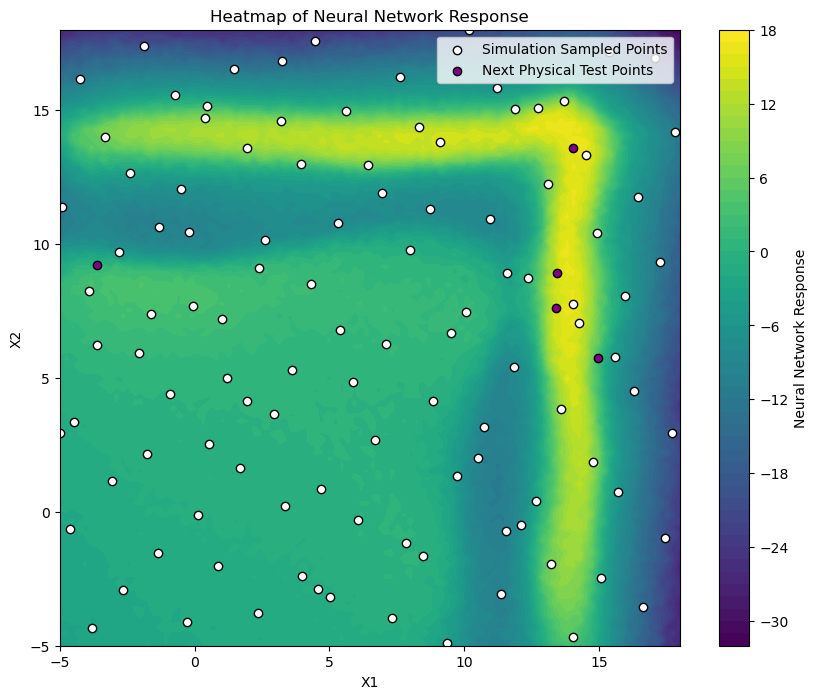

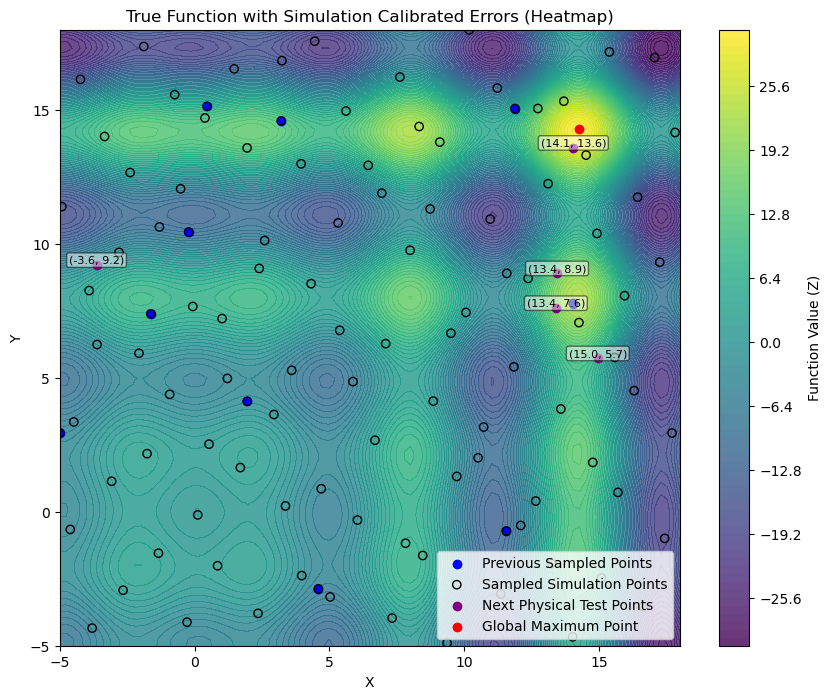

Selected 5 new test points. Median diff: -0.5749
[Iteration 1] RMSE: 1.2481, R²: 0.9860
[ 1.96696177 -3.11940323]


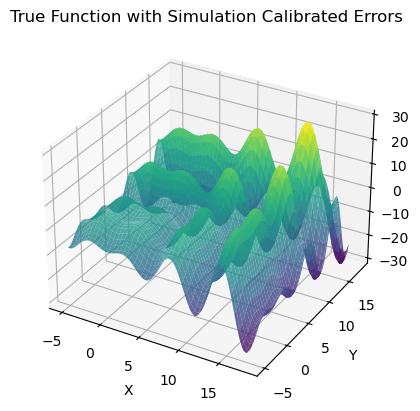

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 115.4983
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 115.6854
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 115.5597
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 114.7654
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 114.7245
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 114.3504
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 114.7534
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 114.1390
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 113.8800
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 113.5505
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 113.1285
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 112.9568
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 113.1423
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 112.3715
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 

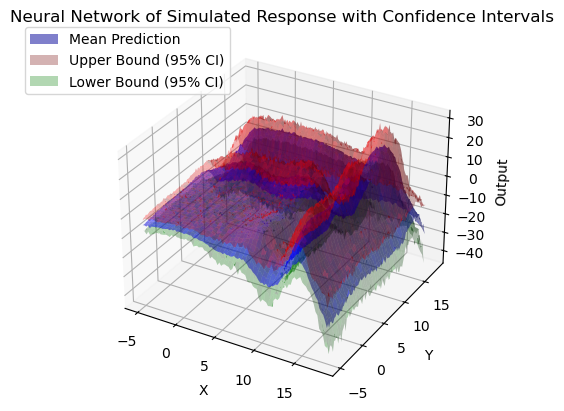

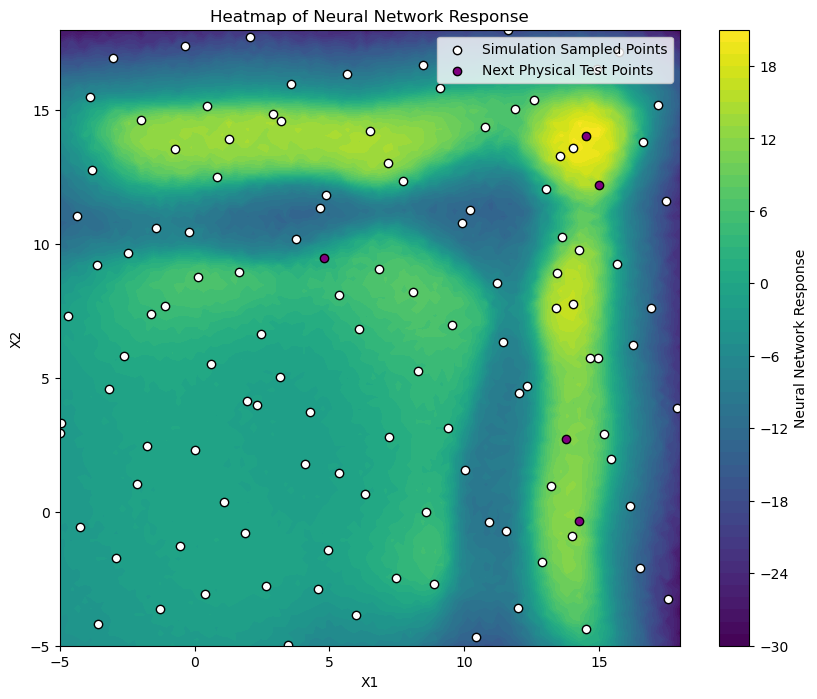

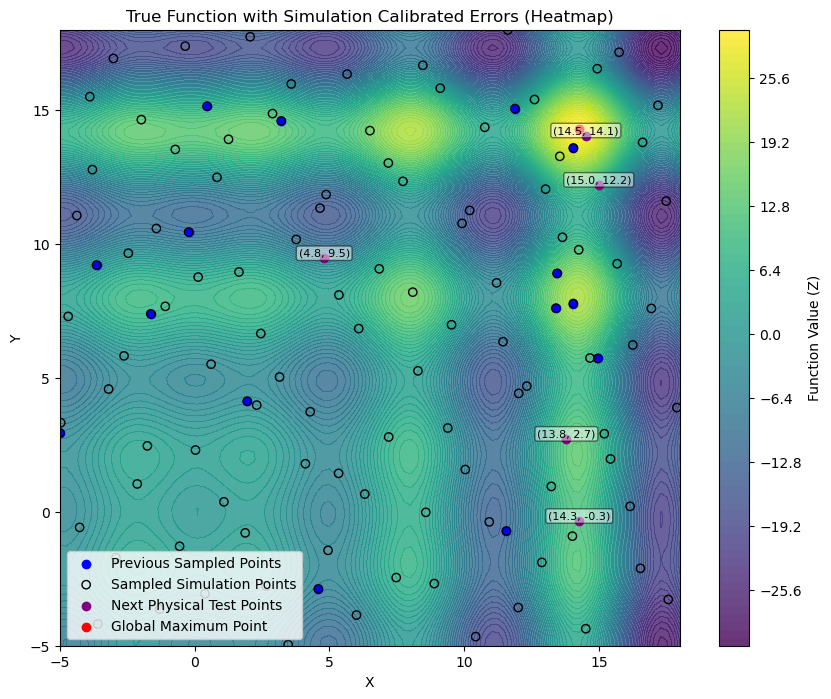

Selected 5 new test points. Median diff: 0.1081
[Iteration 2] RMSE: 1.4233, R²: 0.9828
[ 2.37759593 -3.23563546]


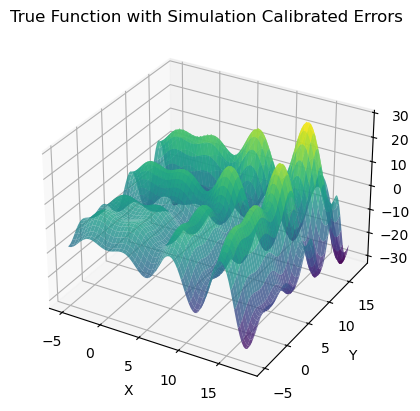

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 138.6399
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 139.0741
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 138.5312
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 138.5314
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 137.9408
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 137.8093
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 137.8174
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 137.8914
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 137.8018
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 137.6571
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 136.8649
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 137.3244
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 136.6661
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 135.8621
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 

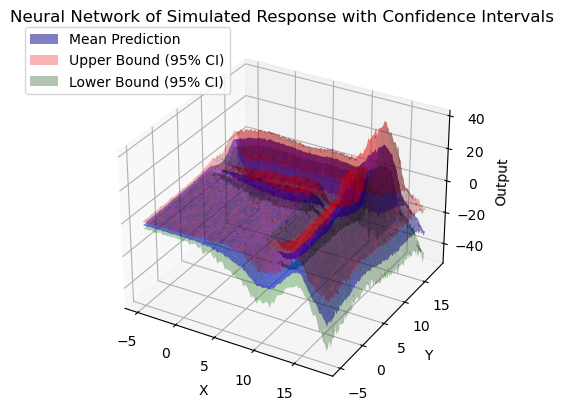

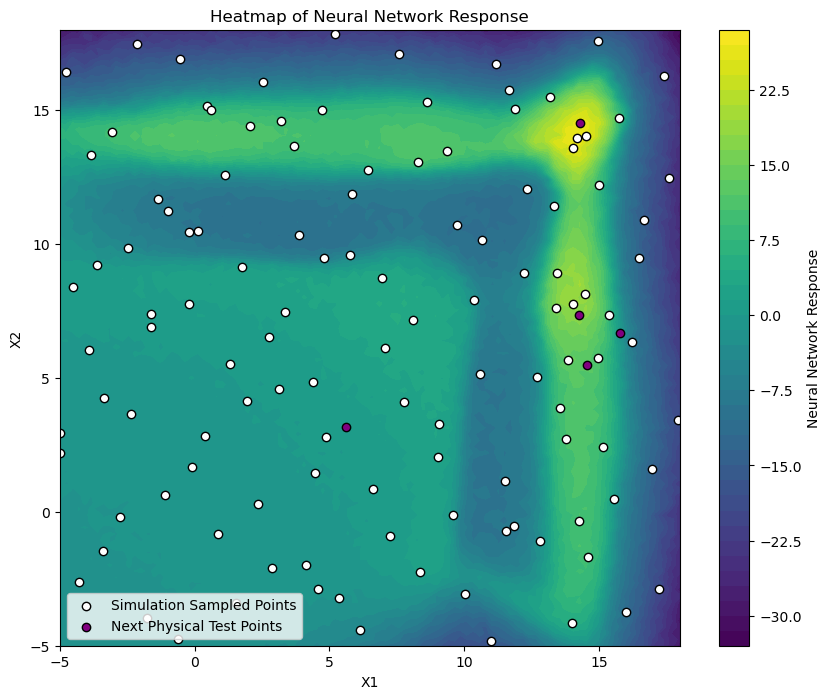

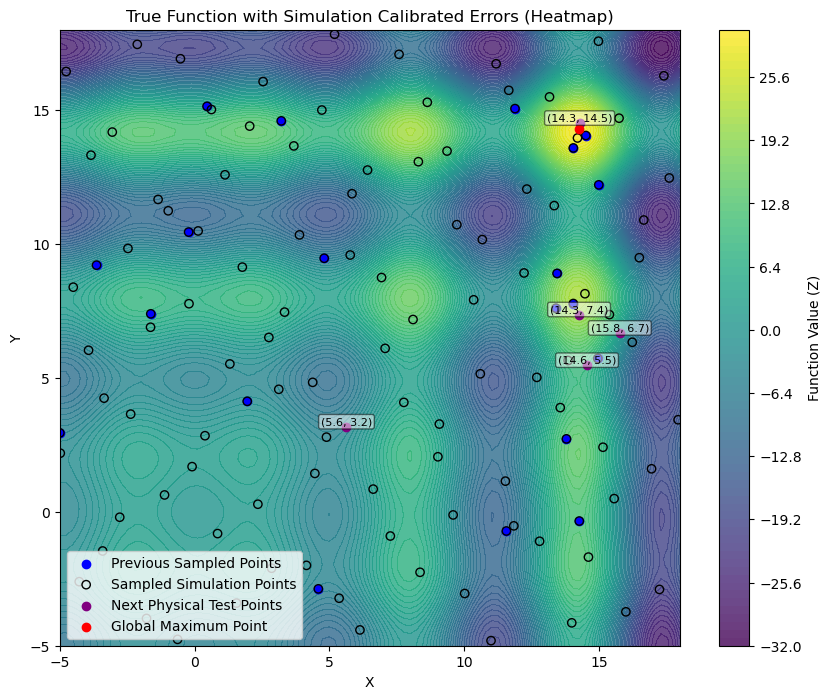

Selected 5 new test points. Median diff: -0.0868
[Iteration 3] RMSE: 1.2309, R²: 0.9877
[ 2.4767842  -3.25071879]


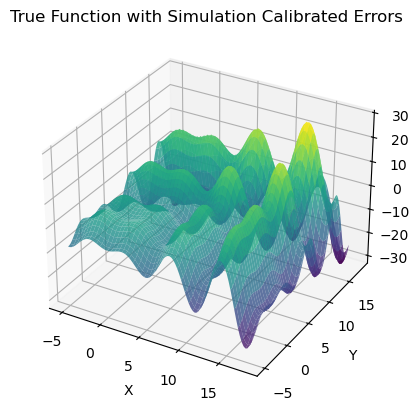

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 410.8660
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 411.6661
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 410.3903
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 409.4569
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 409.8675
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 408.7067
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 408.4874
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 407.5866
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 406.3026
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 404.2566
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 404.7668
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 402.6634
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 400.3311
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 395.9890
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 

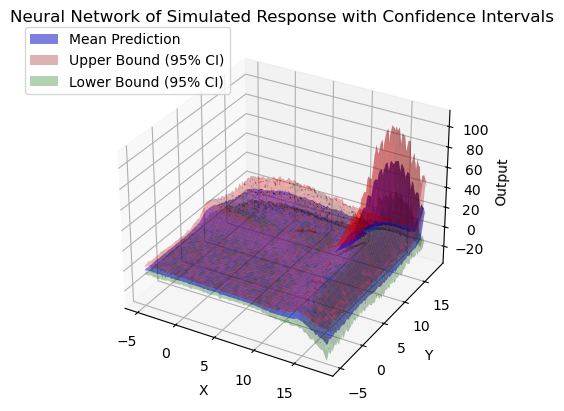

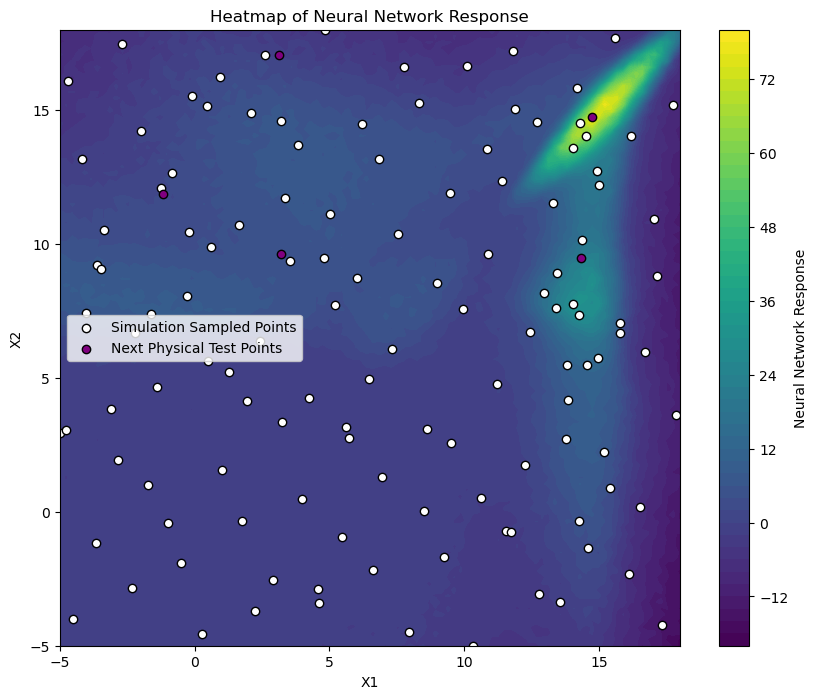

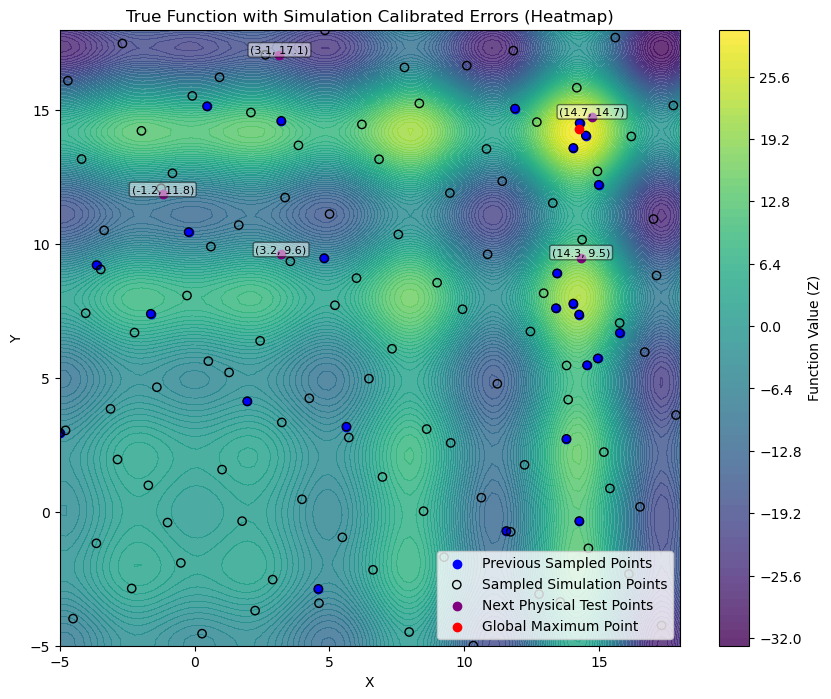

Selected 5 new test points. Median diff: 0.7408
[Iteration 4] RMSE: 26.9571, R²: -4.0972
[ 1.92449875 -3.15508064]


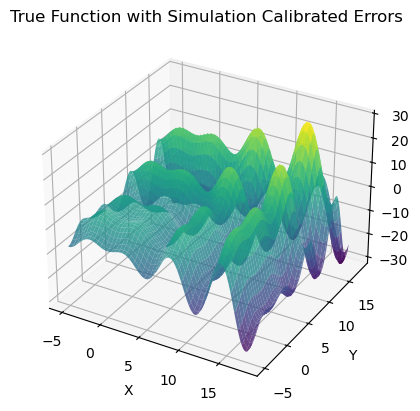

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 1284.8976
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 1284.7468
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 1279.3817
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 1278.5713
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 1276.5396
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 1268.8794
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 1265.3649
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 1261.0232
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 1248.9110
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 1235.0090
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 1226.5393
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 1202.9164
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 1180.7313
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 1151.5913
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms

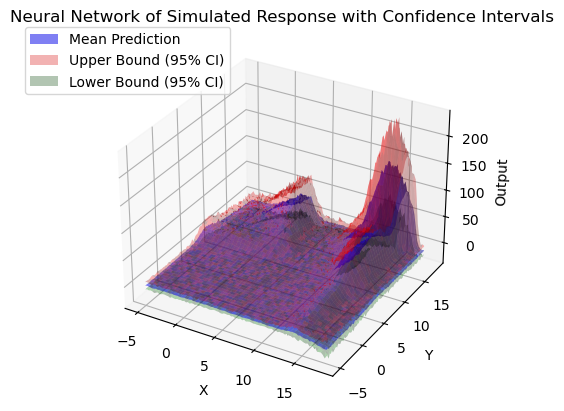

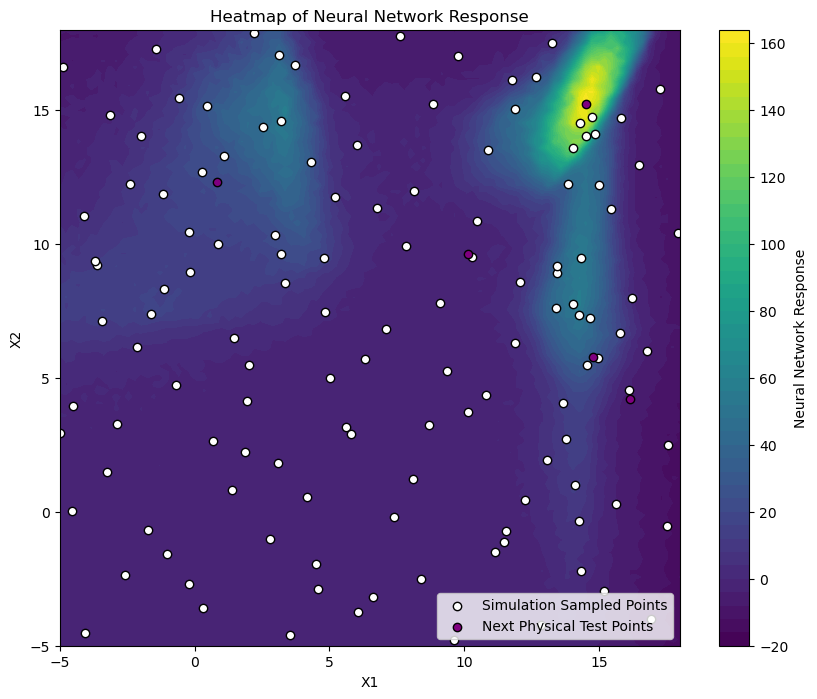

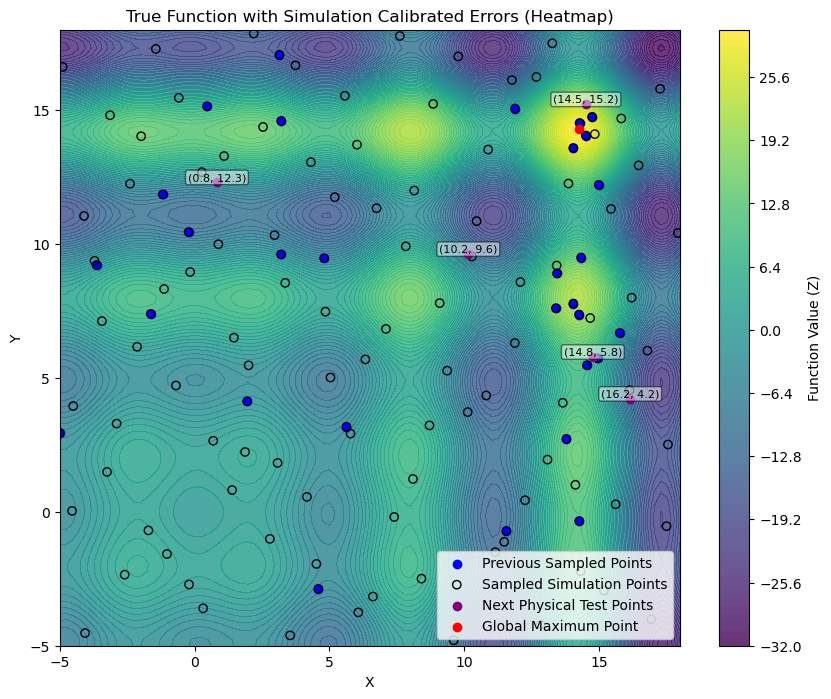

Selected 5 new test points. Median diff: 0.7616
[Iteration 5] RMSE: 58.8749, R²: -22.7472
[ 1.88721389 -3.16218301]


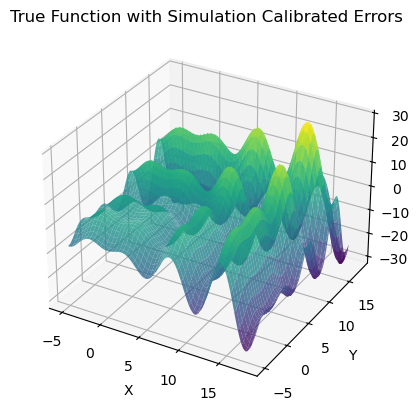

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 431.5479
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 430.1038
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 429.1334
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 427.9550
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 427.2047
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 425.2745
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 423.4342
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 420.8391
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 416.0269
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 415.7782
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 410.5122
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 403.3246
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 396.9386
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 387.9773
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 

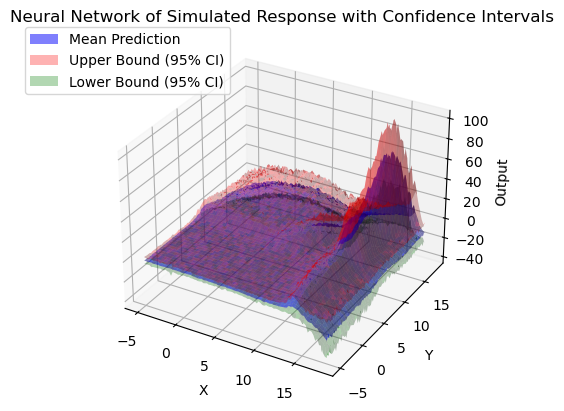

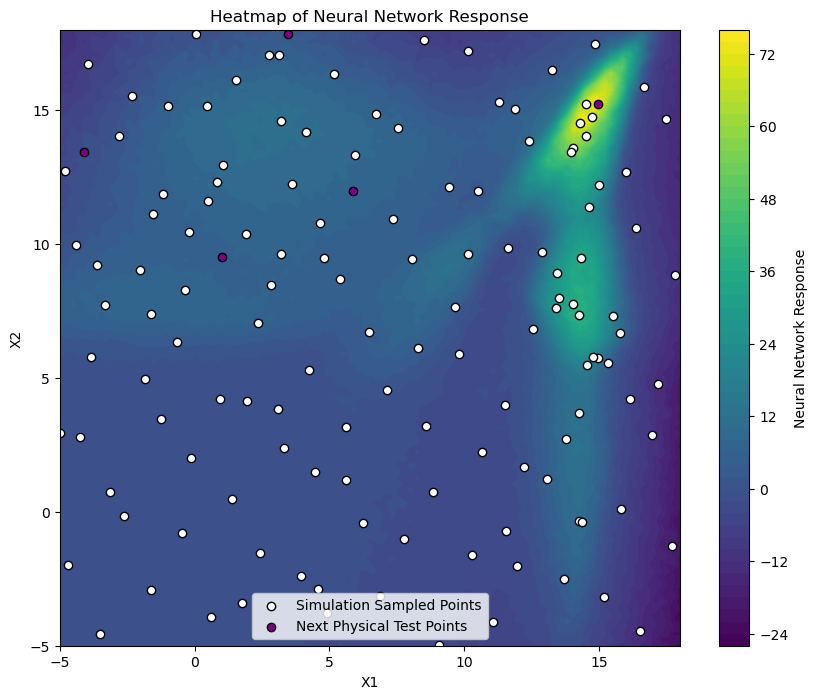

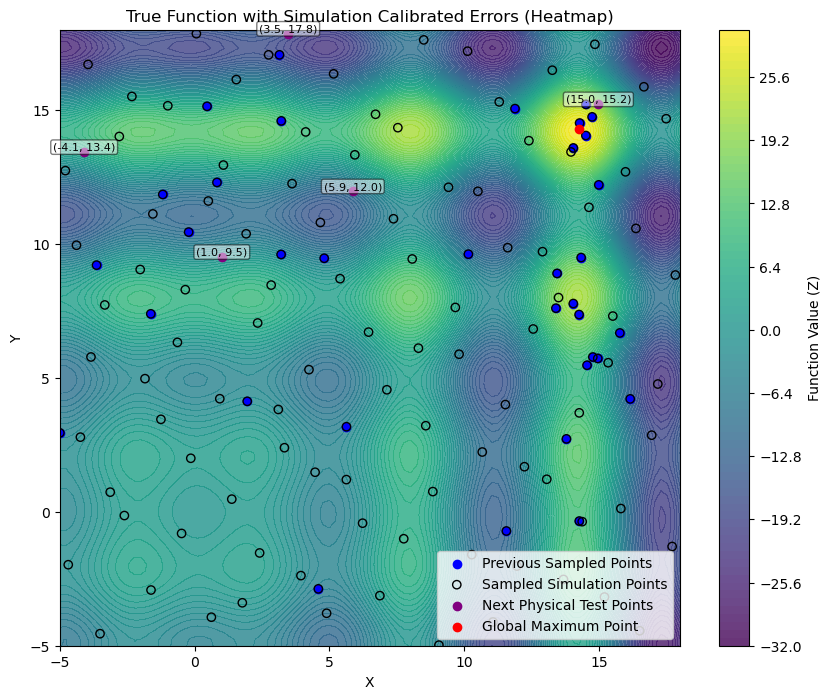

Selected 5 new test points. Median diff: 0.6949
[Iteration 6] RMSE: 25.1243, R²: -3.2186

=== Running with 10 physical experiments ===
[ 2.6481585 -3.1603278]


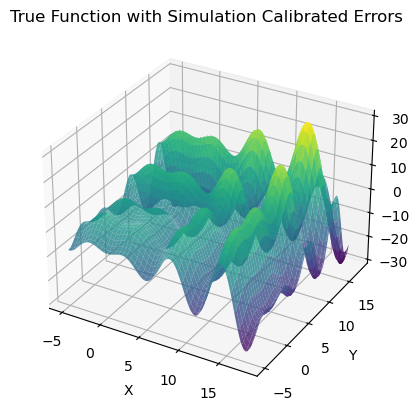

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 197.1077
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 197.0360
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 196.4941
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 196.7768
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 196.7278
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 196.3517
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 196.3260
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 196.0701
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 195.9048
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 195.8949
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 195.5033
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 195.9865
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 196.0672
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 195.9645
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 

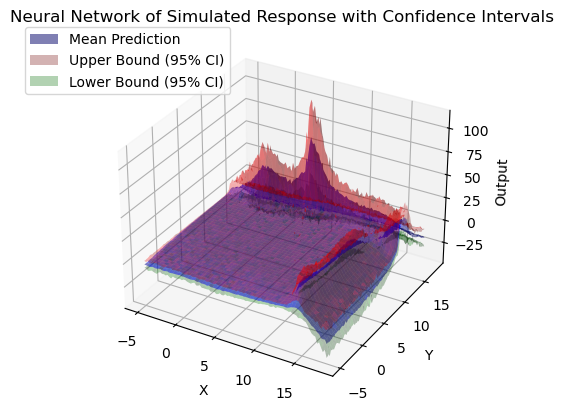

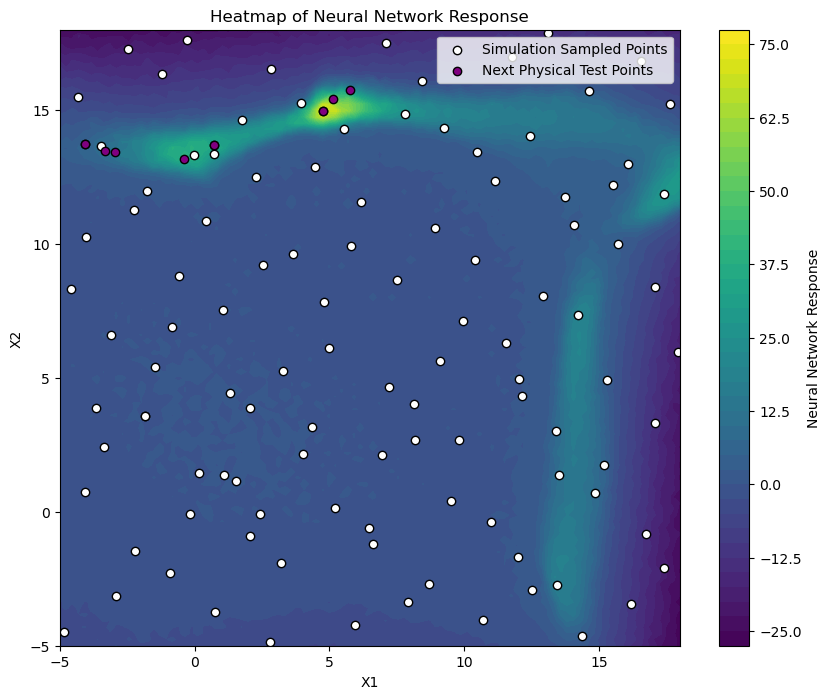

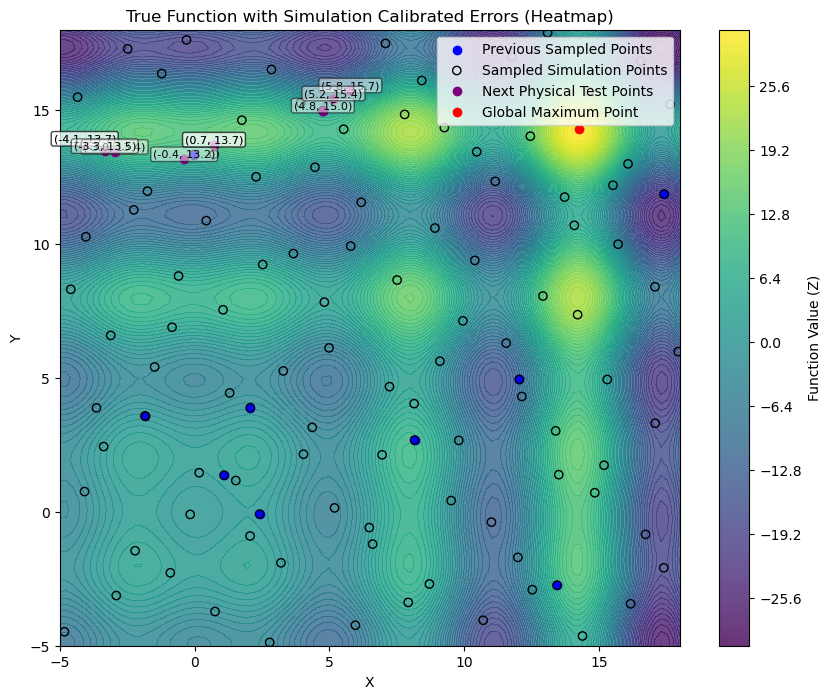

Selected 10 new test points. Median diff: 1.3572
[Iteration 0] RMSE: 23.9027, R²: -6.1844
[ 1.76422203 -3.02366372]


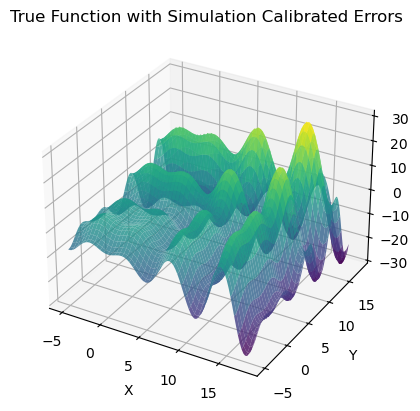

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 145.0611
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 143.9606
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 143.4175
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 143.5588
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 142.0943
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 141.5709
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 141.2295
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 139.4316
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 137.7645
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 136.9238
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 134.7241
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 132.2127
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 132.8151
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 127.2610
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 

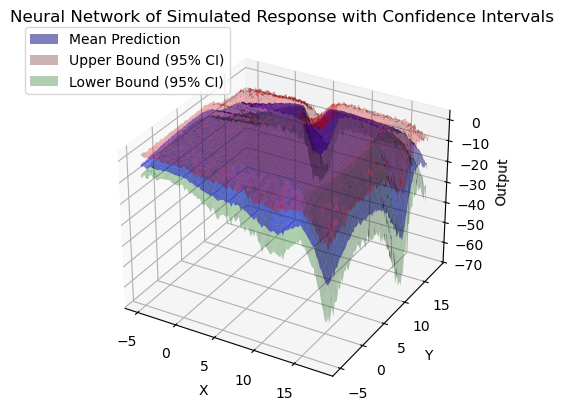

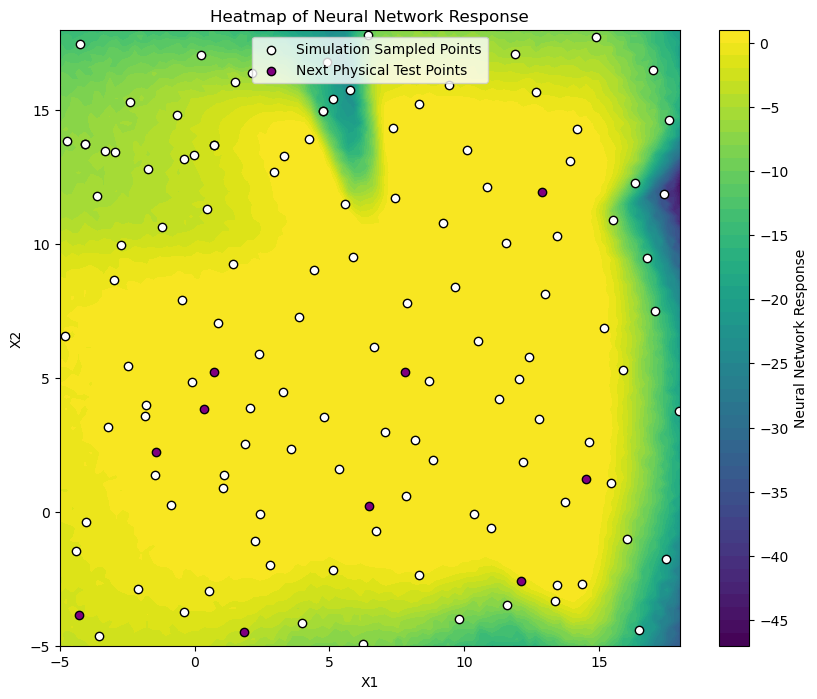

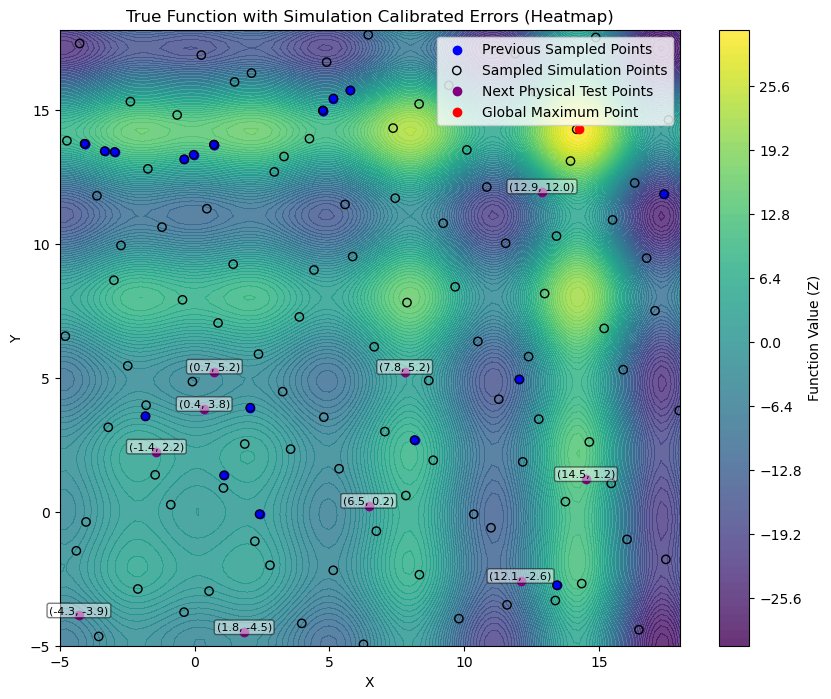

Selected 10 new test points. Median diff: 0.3098
[Iteration 1] RMSE: 14.2631, R²: -2.0168
[ 2.53108015 -3.04923386]


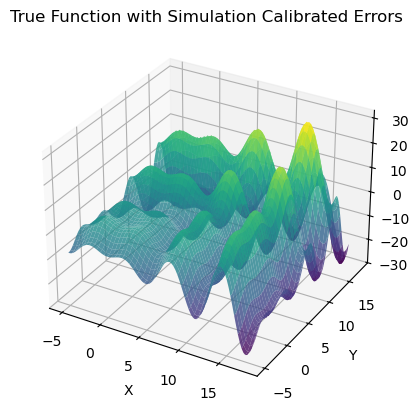

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 161.6889
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 161.2452
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 160.2266
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 159.7375
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - loss: 158.6683
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 157.2729
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 155.5722
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 155.8487
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 152.9147
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 151.0052
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 150.5211
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 145.1315
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 145.3372
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 143.9040
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 

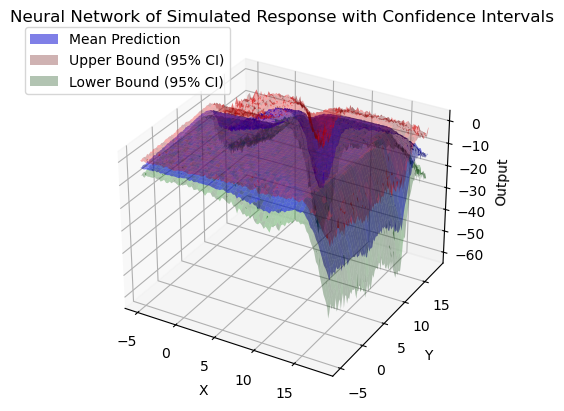

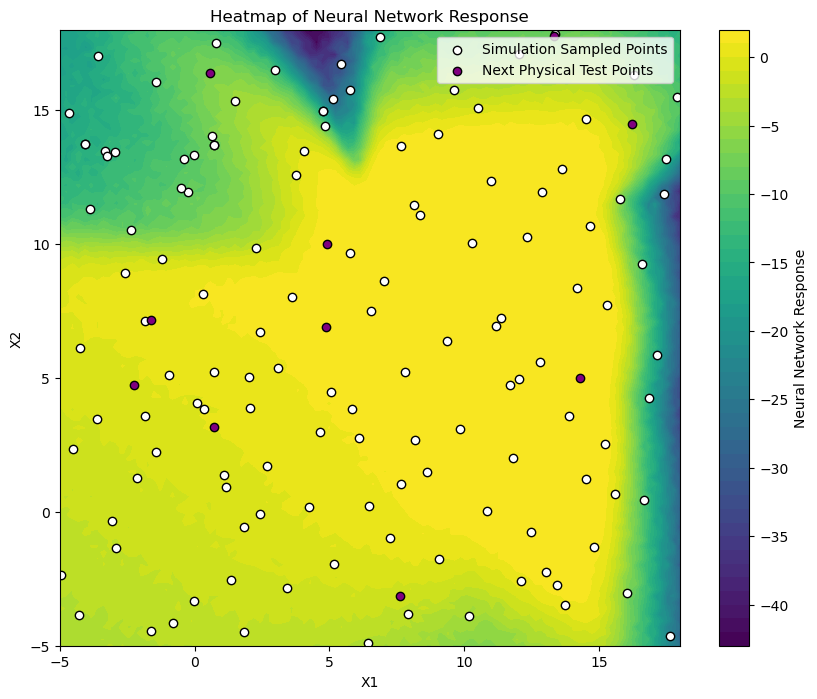

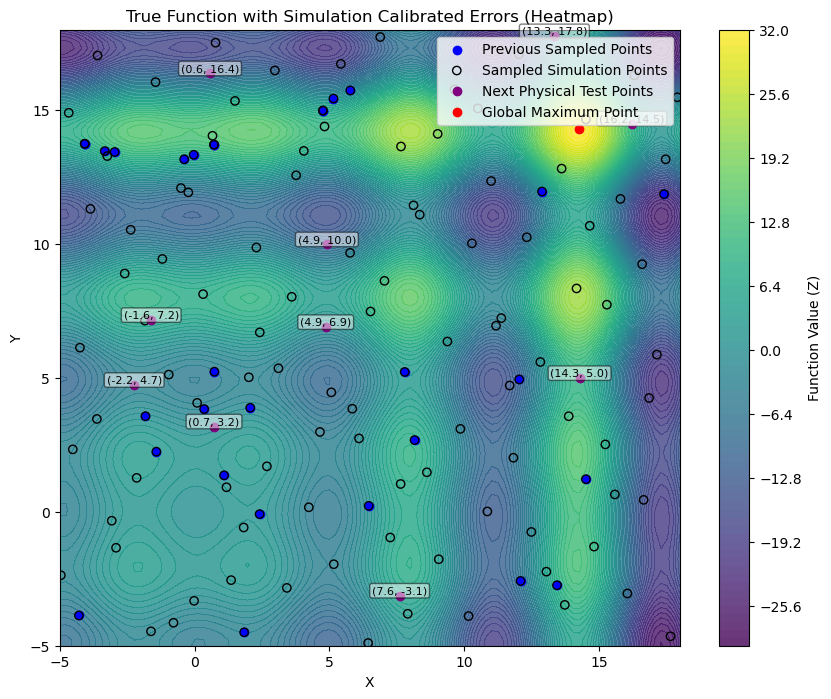

Selected 10 new test points. Median diff: 0.0100
[Iteration 2] RMSE: 16.8977, R²: -3.4902
[ 2.20643186 -3.1044168 ]


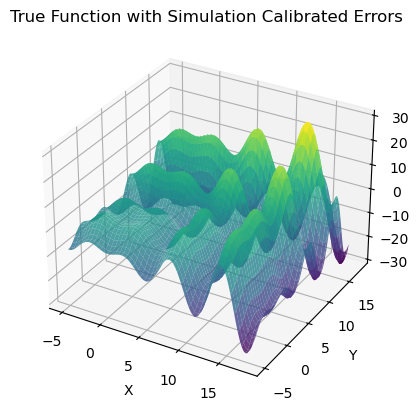

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 102.1995
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 102.0658
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 102.0676
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 101.7827
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 101.3605
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 101.5316
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 101.1088
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 100.9666
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 100.7435
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 100.5219
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 99.8839
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 99.9293
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 99.7791
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 99.8378
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 99.2

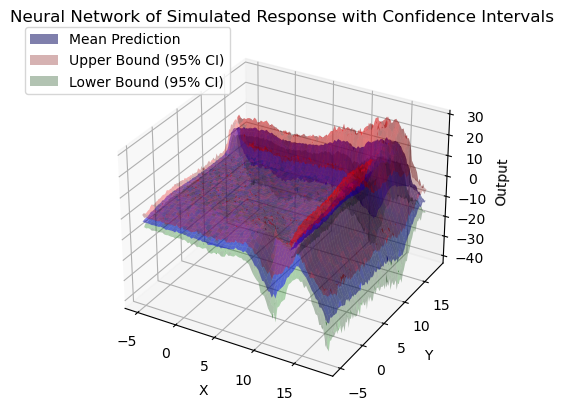

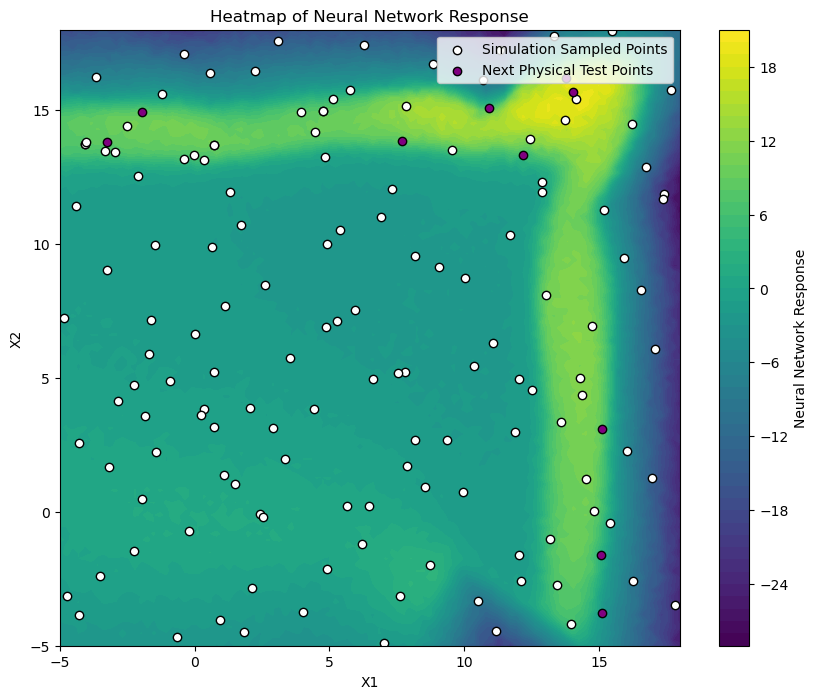

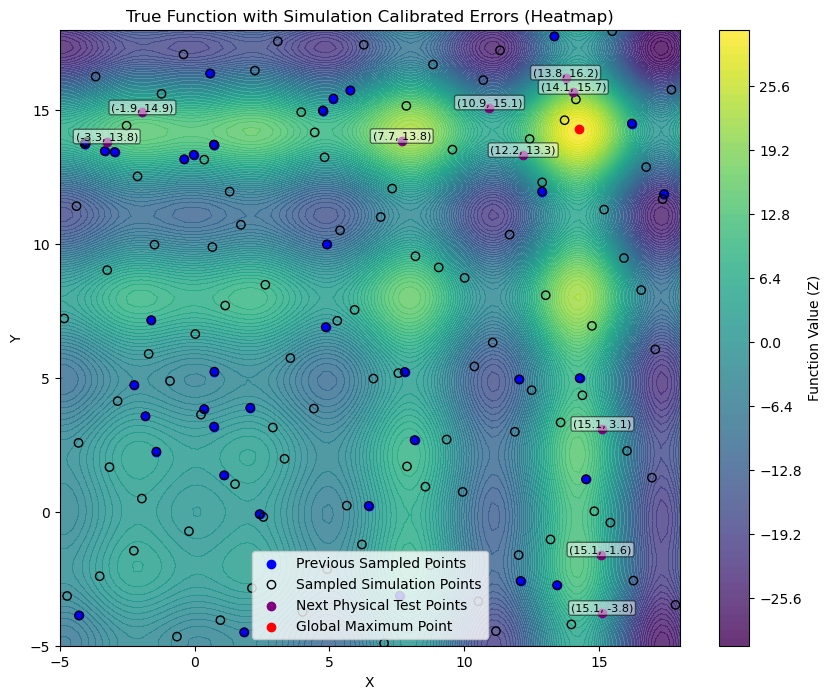

Selected 10 new test points. Median diff: 0.2583
[Iteration 3] RMSE: 1.7311, R²: 0.9553
[ 2.52768147 -3.1706631 ]


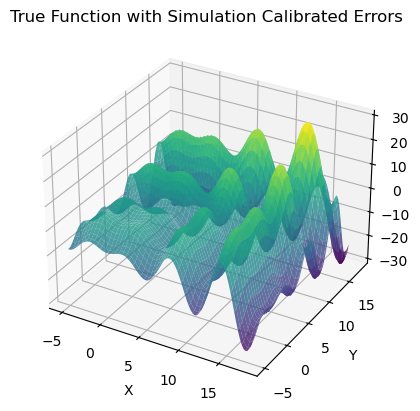

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 100.3498
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 100.5279
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 100.1570
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 100.1456
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - loss: 100.0995
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 99.8531
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - loss: 99.7714
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - loss: 100.0449
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - loss: 100.0564
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 99.6002
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - loss: 99.3324
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - loss: 99.4956
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 98.9737
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - loss: 99.7791
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - loss: 99.3533

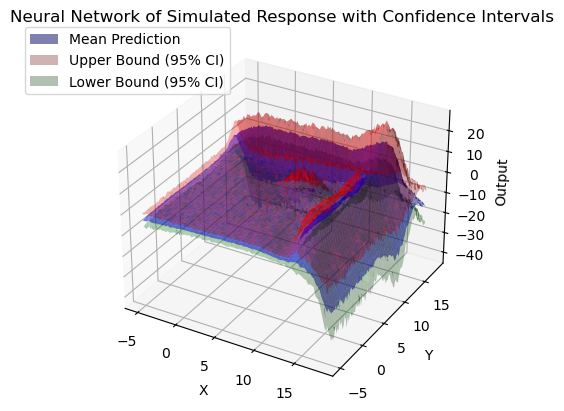

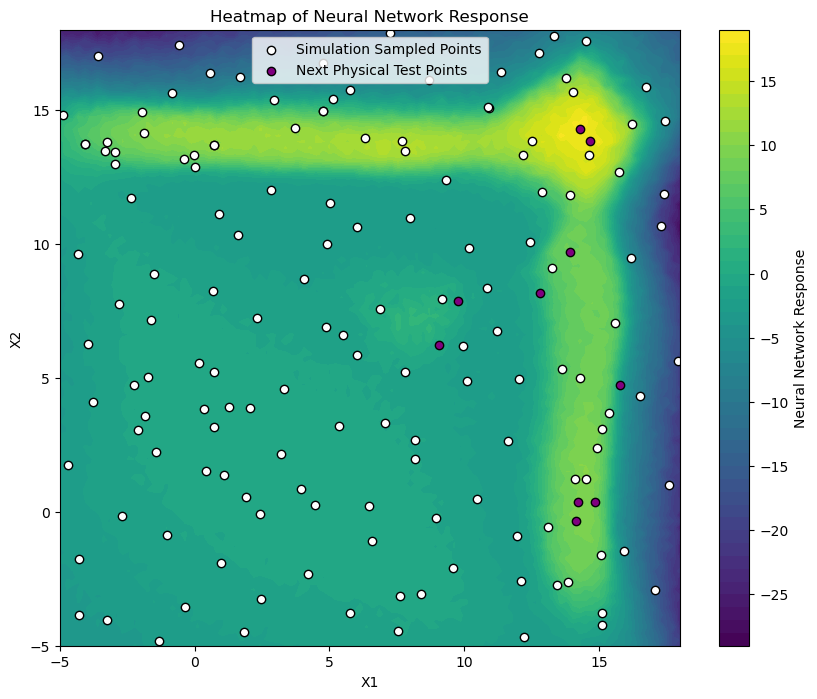

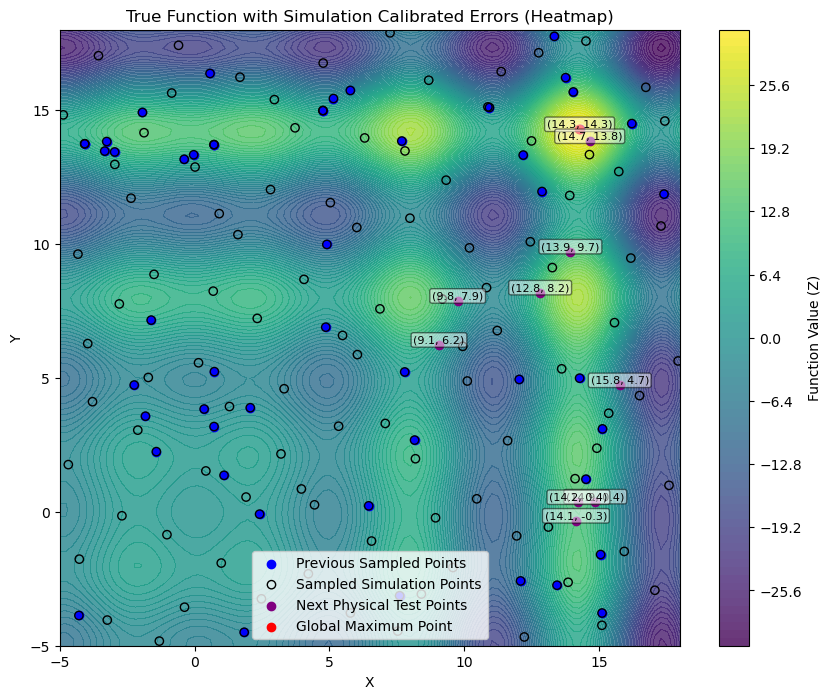

Selected 10 new test points. Median diff: -0.1240
[Iteration 4] RMSE: 1.9586, R²: 0.9526
[ 2.26158739 -3.13569503]


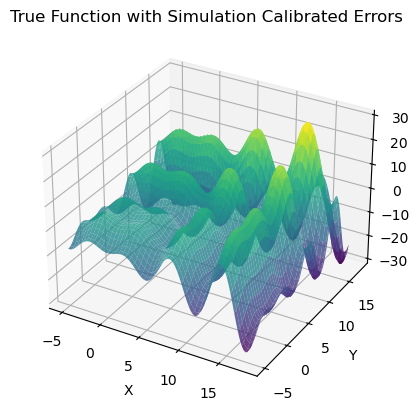

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 281.4775
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 287.1810 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 281.8808 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 278.1679 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 260.6118 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 262.1187 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 247.6820 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 225.6867 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 208.2186 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 202.9561 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 192.3933 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 217.5882 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 211.0440 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 186.2033 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 

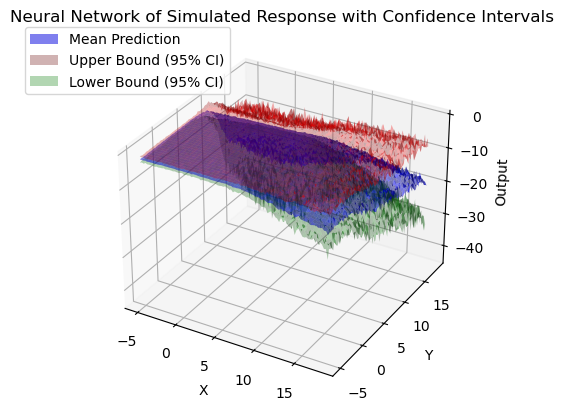

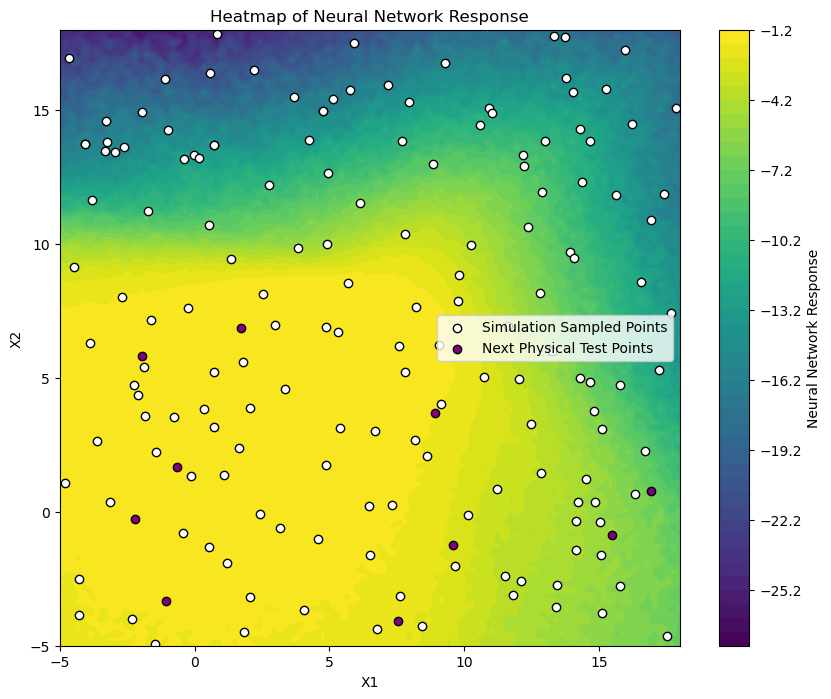

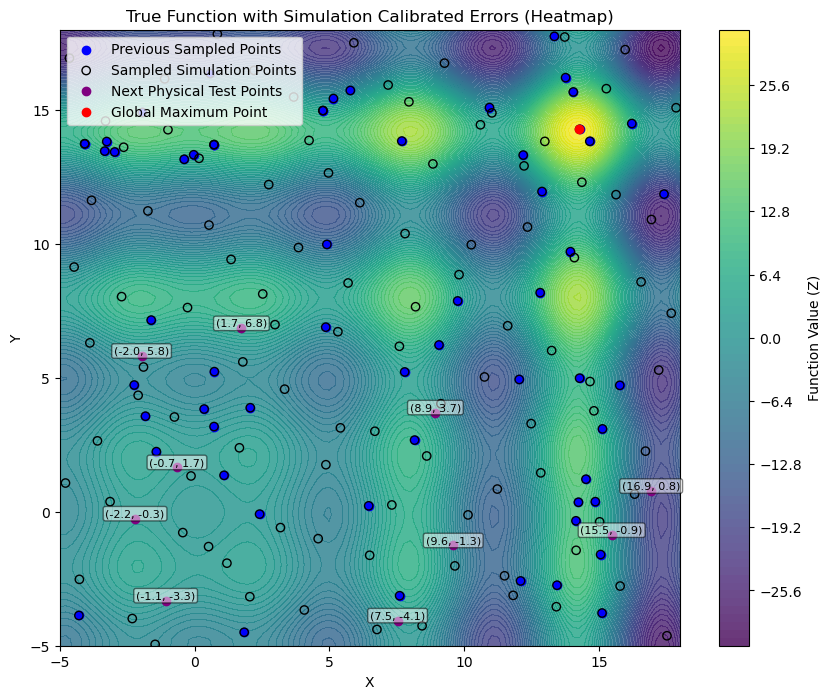

Selected 10 new test points. Median diff: 0.3945
[Iteration 5] RMSE: 25.1359, R²: -7.2916
[ 2.73942839 -3.17270245]


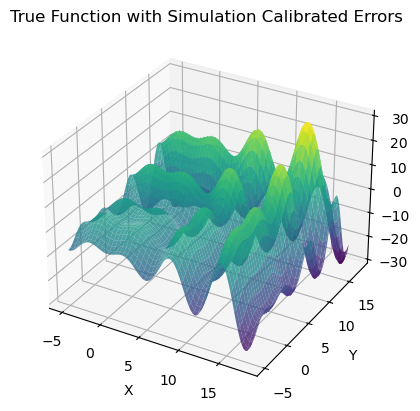

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - loss: 113.7056
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 115.7723 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 110.7087 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 114.5327 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 112.3009 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 113.8792 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 112.6364 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 113.7907 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 112.0346 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 113.0755 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 111.0069 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 113.9699 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 113.4643 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 113.0810 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss:

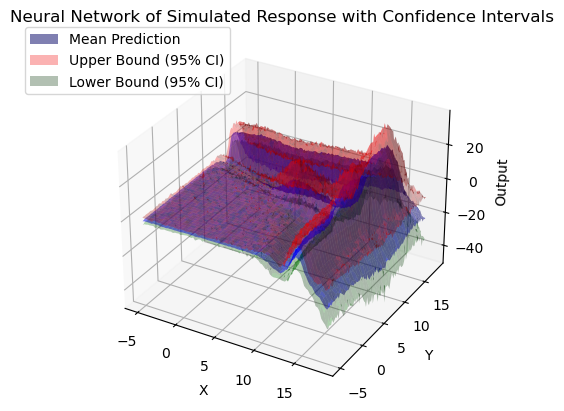

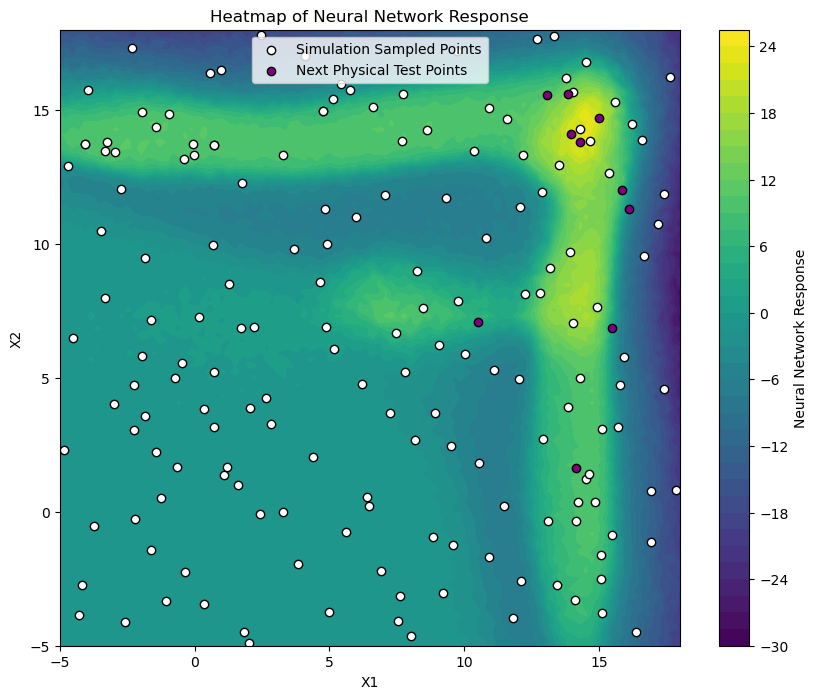

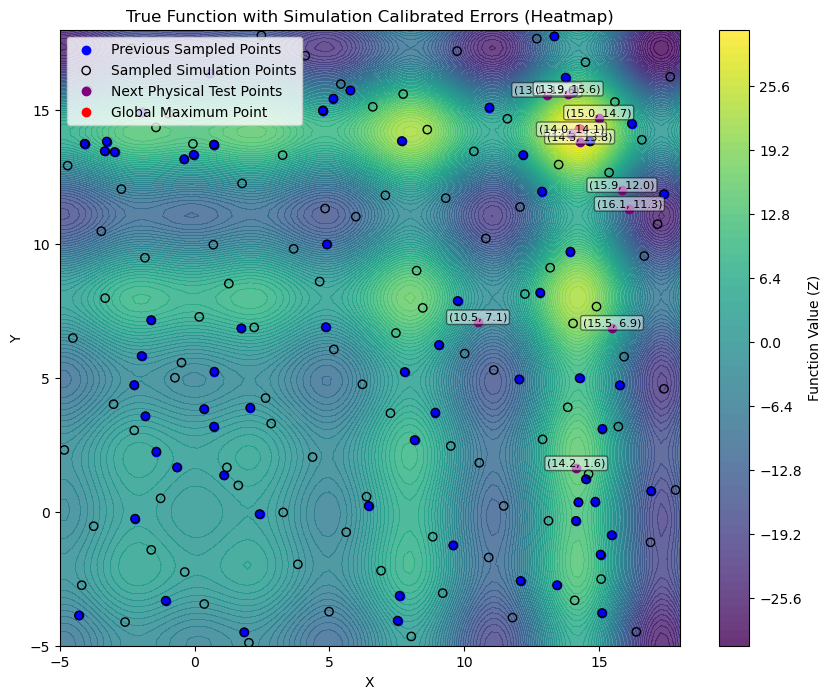

Selected 10 new test points. Median diff: -2.3904
[Iteration 6] RMSE: 1.9525, R²: 0.9604

=== Running with 15 physical experiments ===
[ 3.26802263 -3.35046454]


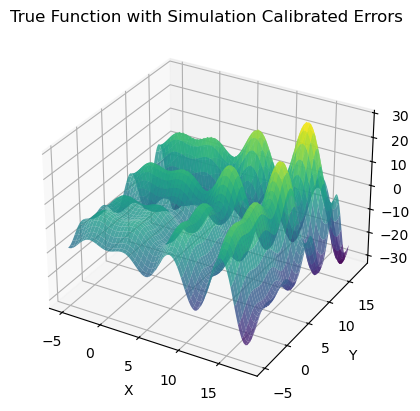

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 123.4267
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 122.6478
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 121.9721
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 120.8229
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 120.0224
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 118.8650
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 116.9084
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 116.1604
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 115.4255
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 110.2537
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 108.8521
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 109.2268
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 108.9485
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 109.7914
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 

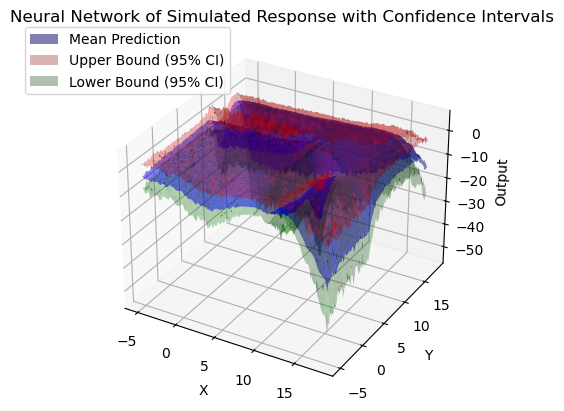

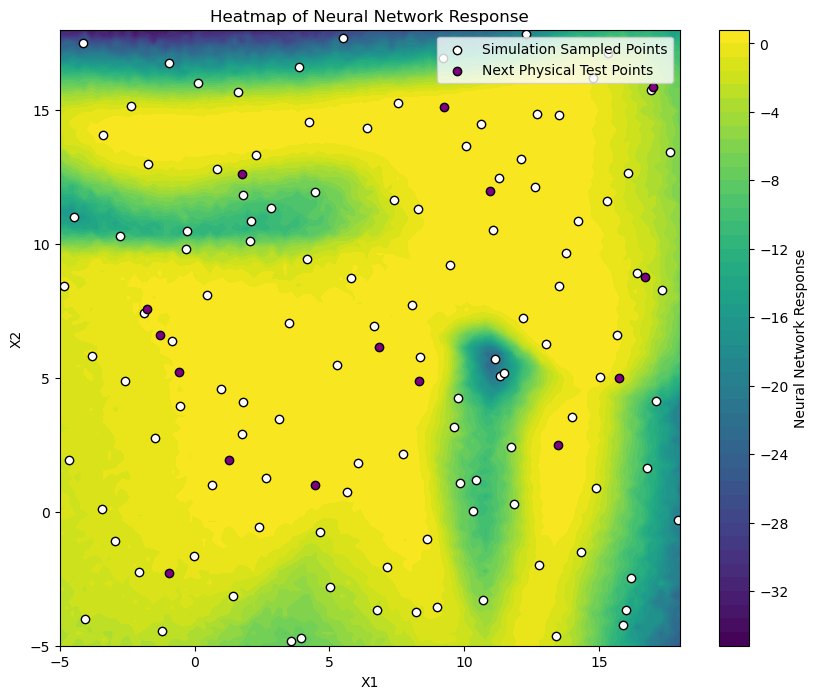

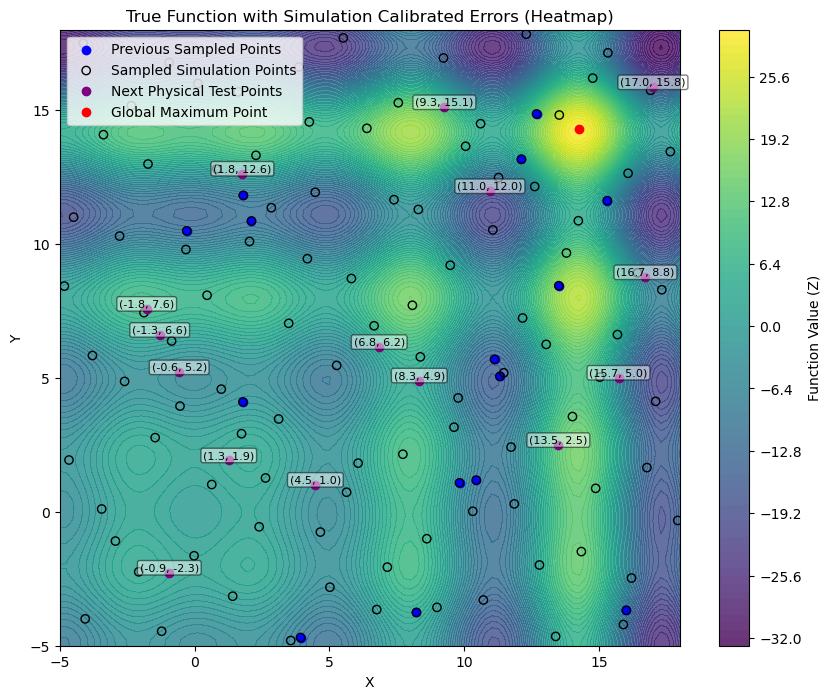

Selected 15 new test points. Median diff: 0.0492
[Iteration 0] RMSE: 7.4068, R²: 0.3203
[ 3.00868712 -3.36601499]


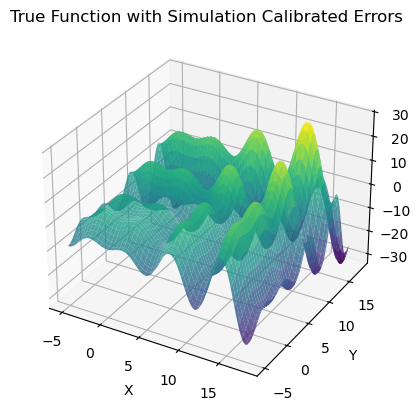

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 116.8519
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 116.3664
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 116.0349
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 115.6152
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 115.1723
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 113.9416
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 113.4103
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 113.5418
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 111.9217
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 109.9510
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 110.2522
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 110.0914
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 107.9943
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 108.0491
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 

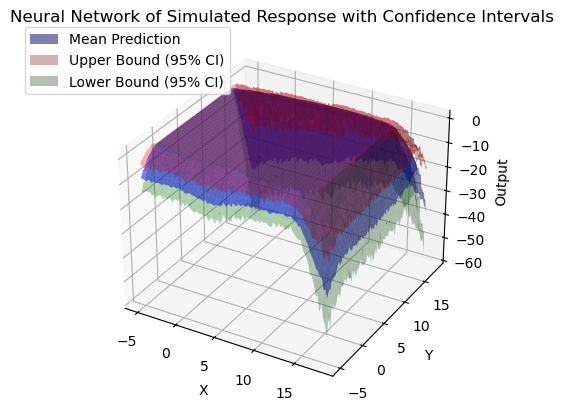

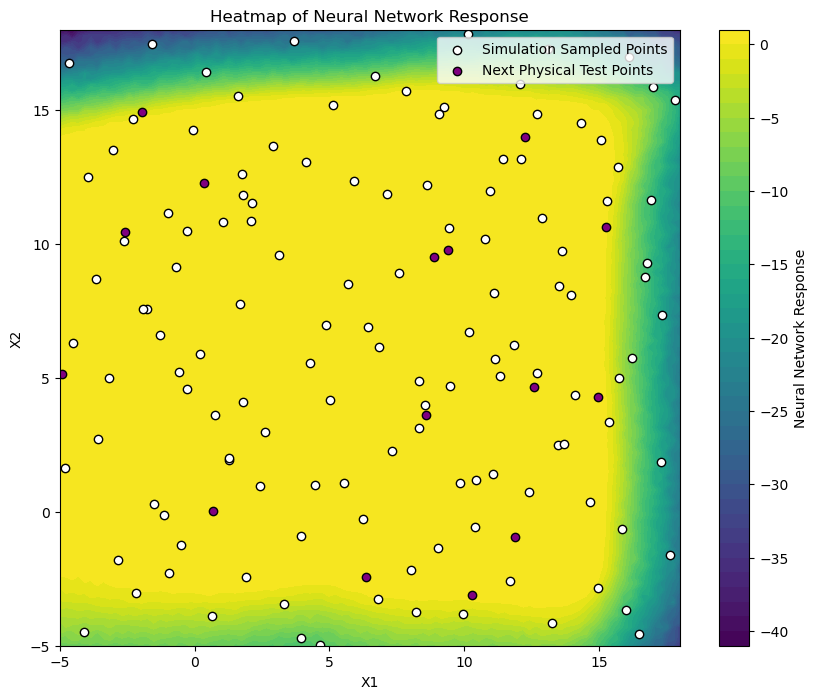

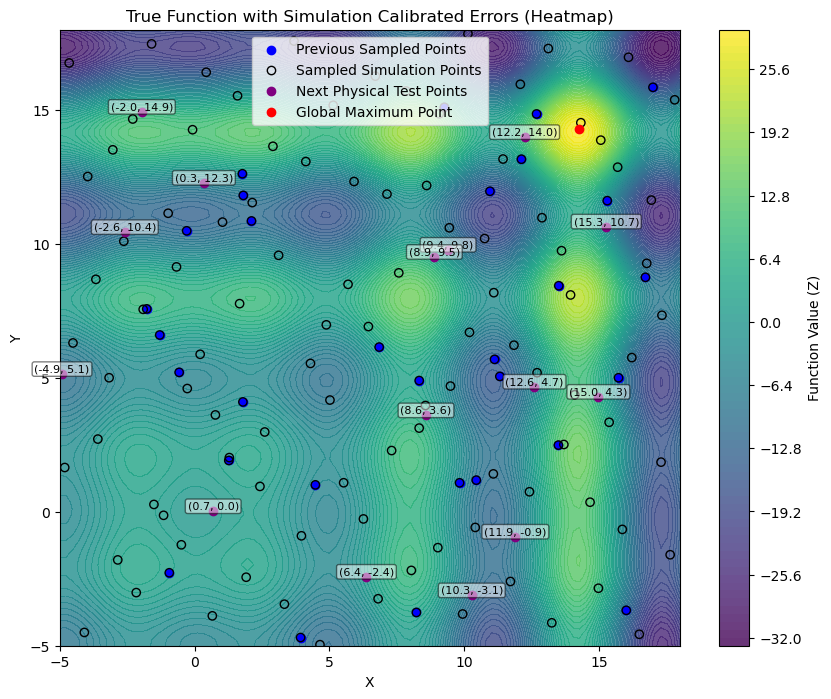

Selected 15 new test points. Median diff: 0.1457
[Iteration 1] RMSE: 1.5406, R²: 0.9652
[ 2.34786204 -3.19561603]


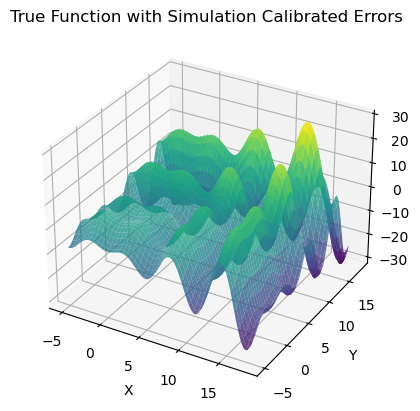

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 103.0381
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 102.1303
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 101.9403
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 101.7547
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 100.9347
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 100.5164
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 98.6258
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 98.9789
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 97.6352
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 96.3389
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 96.5654
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 96.5305
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 99.2558
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 96.9104
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 94.9681


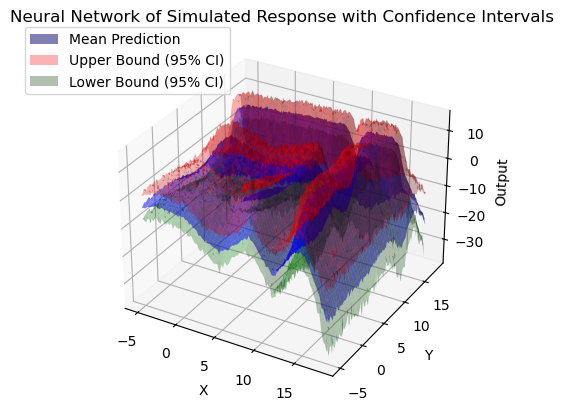

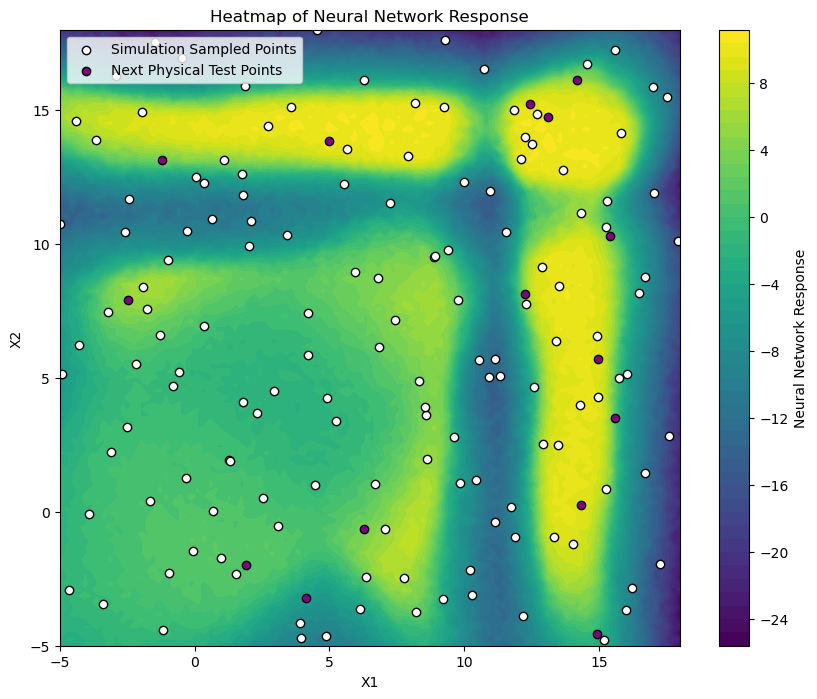

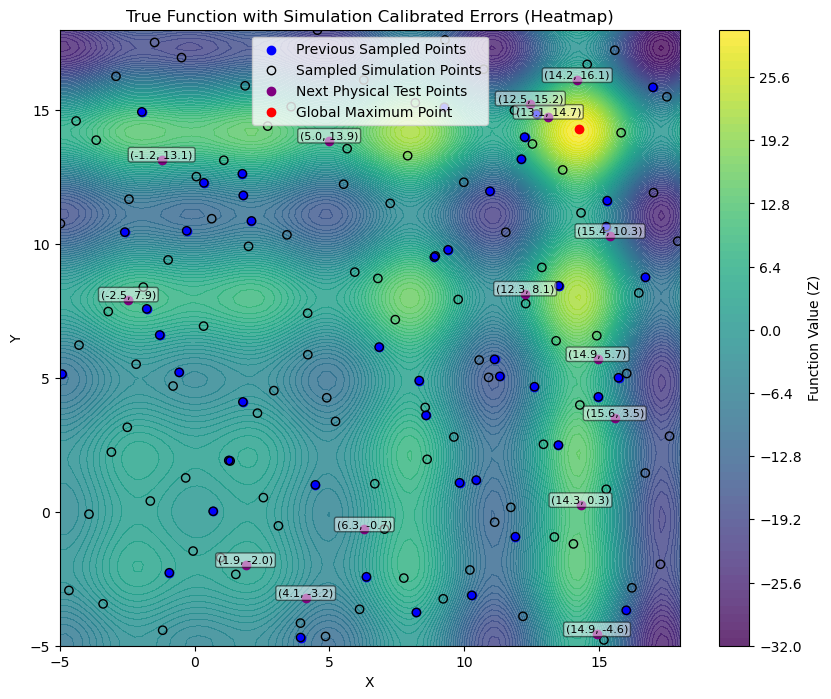

Selected 15 new test points. Median diff: 0.5369
[Iteration 2] RMSE: 1.6302, R²: 0.9617
[ 2.79360739 -3.27341672]


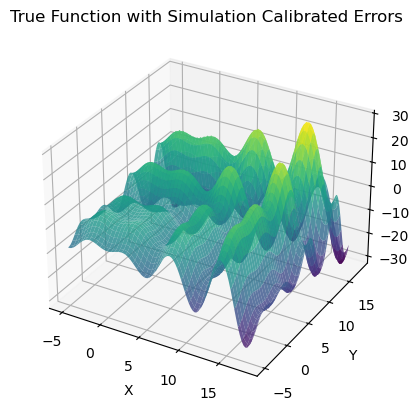

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 107.8580
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 104.4656
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 106.4475 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 104.8794 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 106.1426 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 105.4008 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 103.9148 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 105.1446 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 104.4078 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 103.9173 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 103.7097 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 103.8938 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 103.2985 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 101.1335
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 10

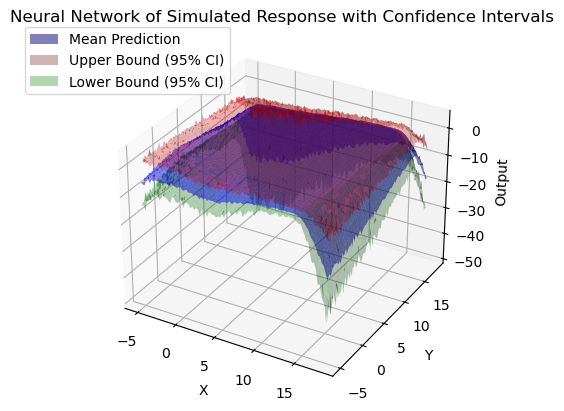

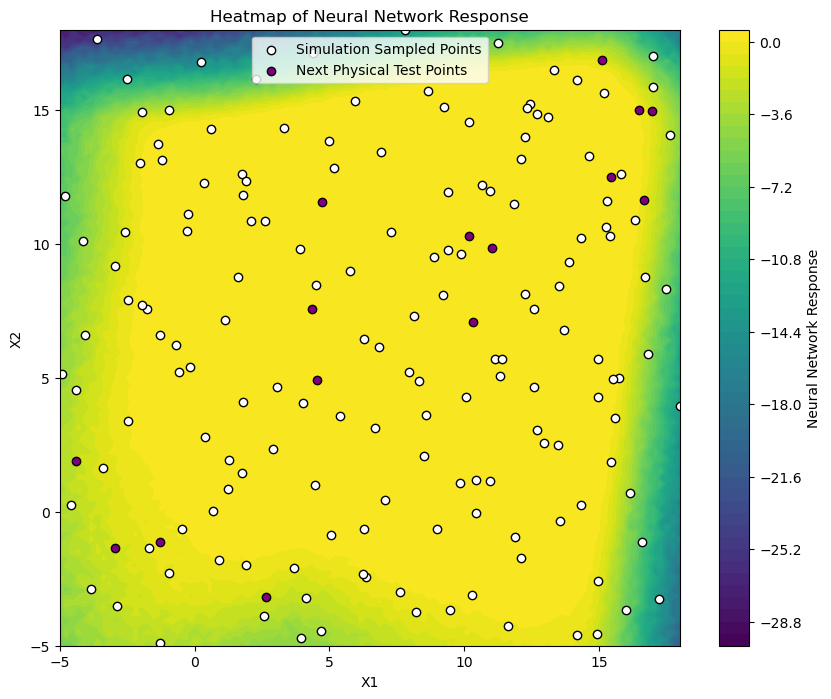

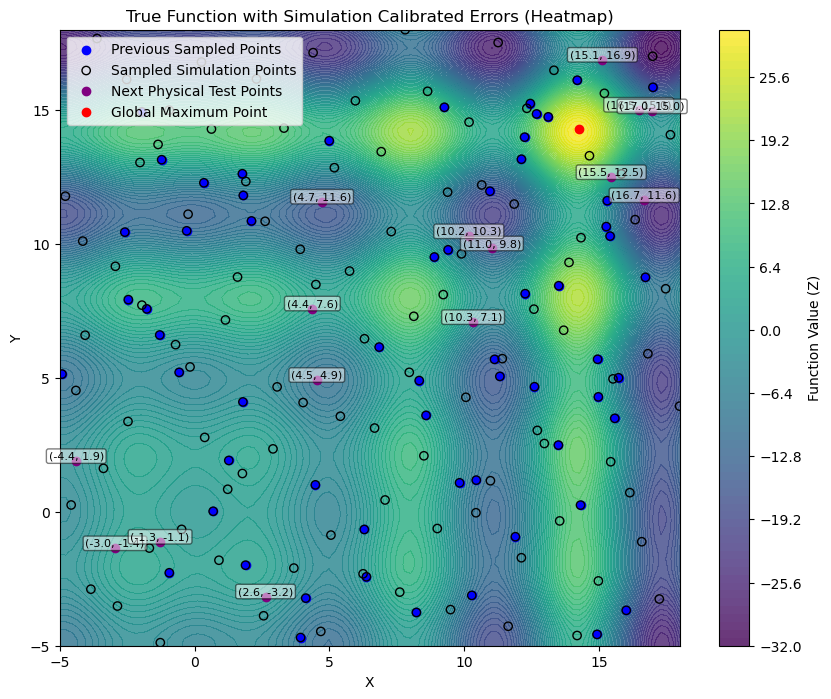

Selected 15 new test points. Median diff: -0.4400
[Iteration 3] RMSE: 1.4814, R²: 0.9702
[ 2.42671628 -3.25249263]


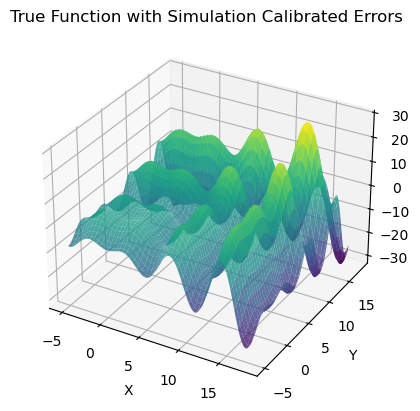

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - loss: 102.8566
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 102.3141 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 103.4651 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 100.8000
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 100.0825
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 103.1488 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 100.7518 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 98.9681 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 99.2868  
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 98.2509 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 101.5012 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 96.0507 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 95.7610 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 97.1467 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 96.180

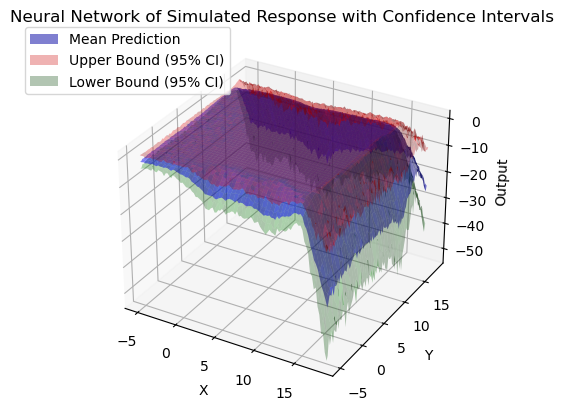

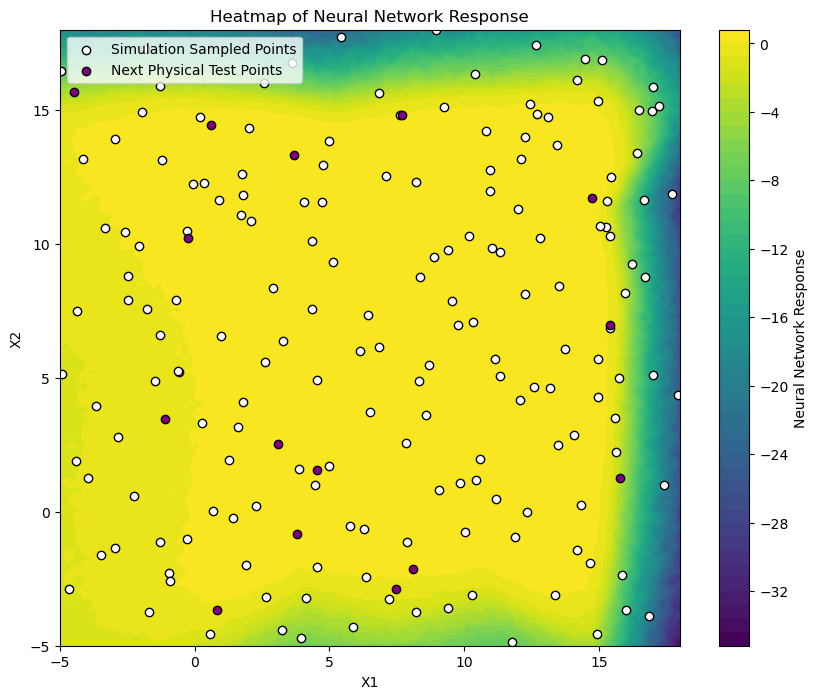

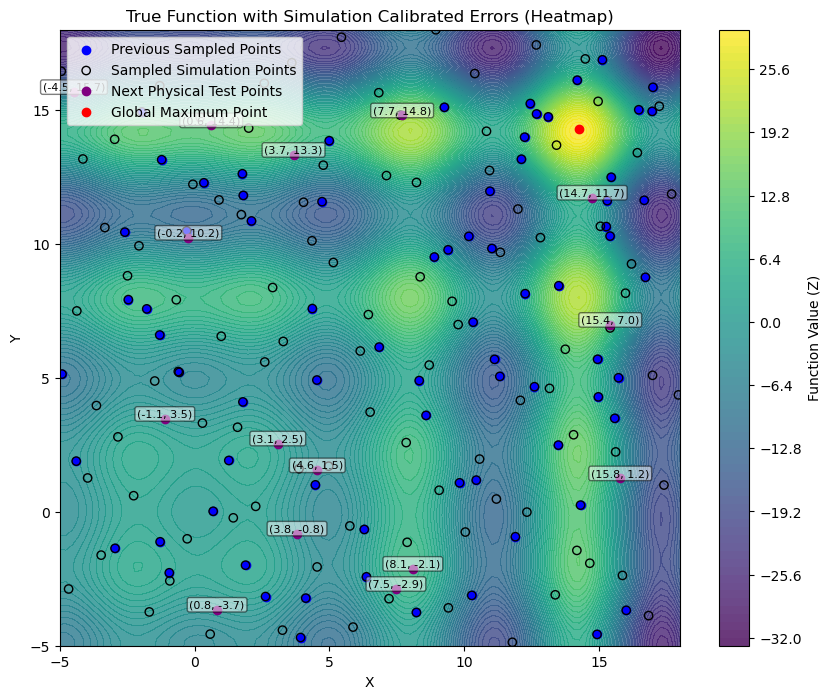

Selected 15 new test points. Median diff: 0.8181
[Iteration 4] RMSE: 1.4769, R²: 0.9699
[ 2.32289036 -3.24281362]


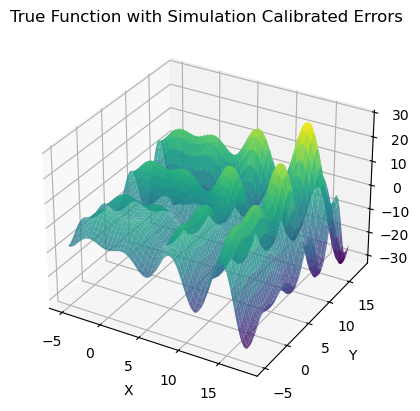

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 104.8070
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 103.8129 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 101.7093 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 99.1840 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 103.0822 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 102.8100 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 99.0373 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 101.7066 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 99.1434 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 99.2232 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 101.9087 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 100.1805 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 97.0365 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 100.5589 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 99.91

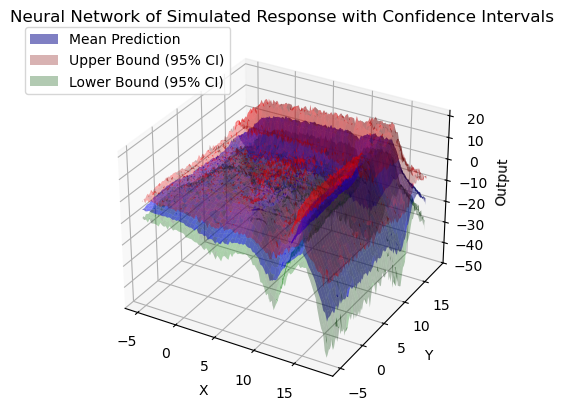

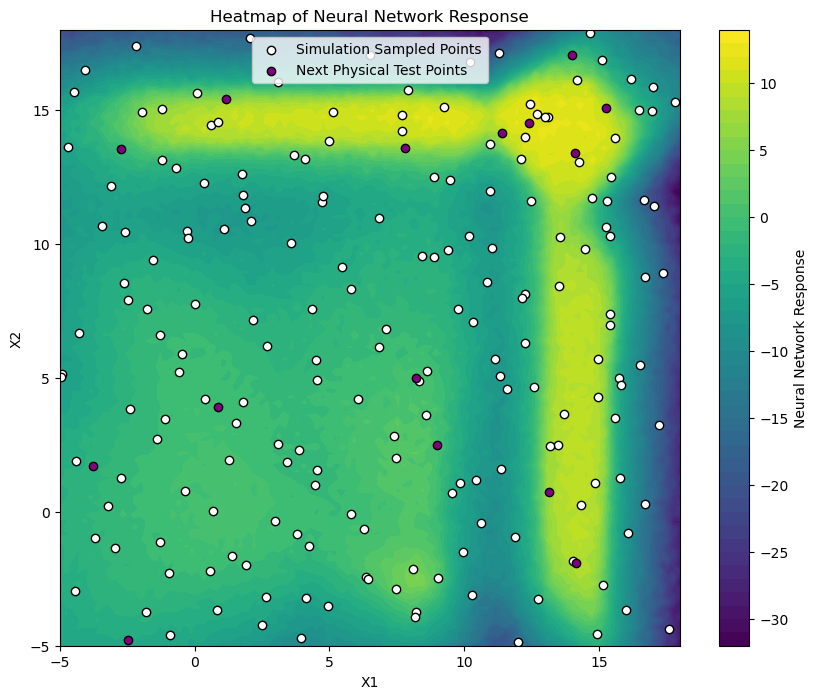

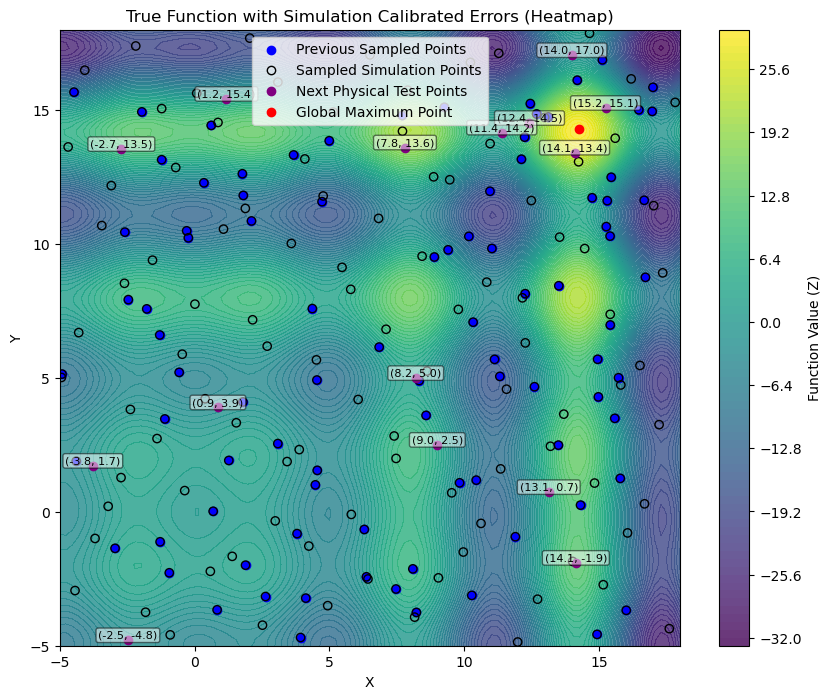

Selected 15 new test points. Median diff: 0.1818
[Iteration 5] RMSE: 1.4895, R²: 0.9720
[ 2.530926   -3.23717679]


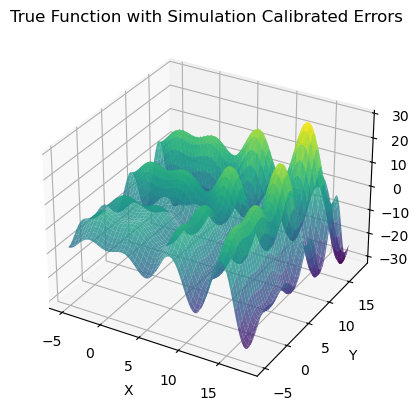

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 109.4482
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 107.8798 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 104.7024 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 108.8677 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 107.2502 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 103.8382
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 103.3294
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 108.1642 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 105.8474 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 104.9556 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 103.1495
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 107.4798 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 107.2228 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 107.3061 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 105

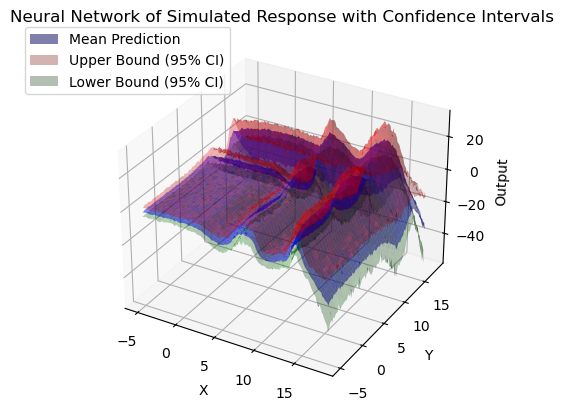

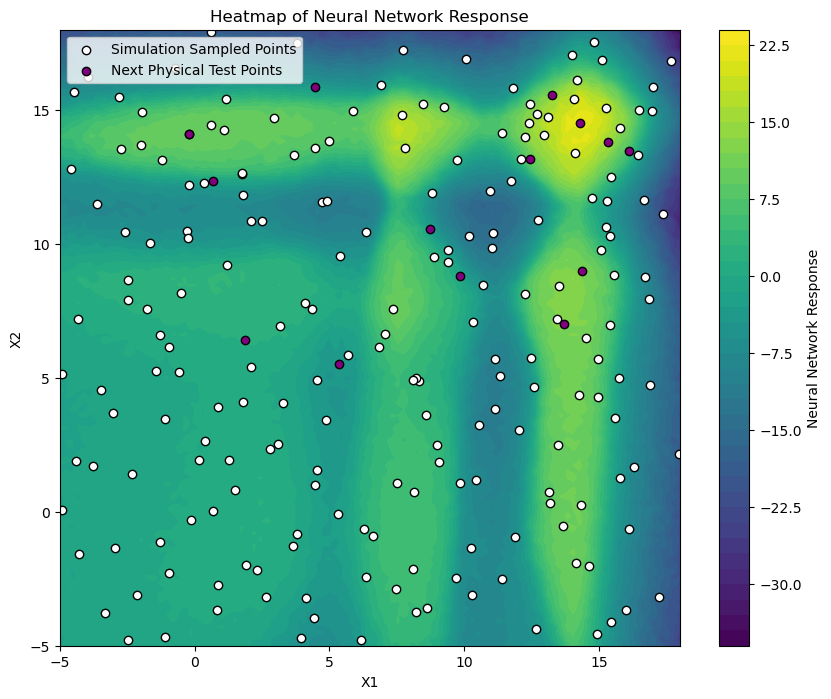

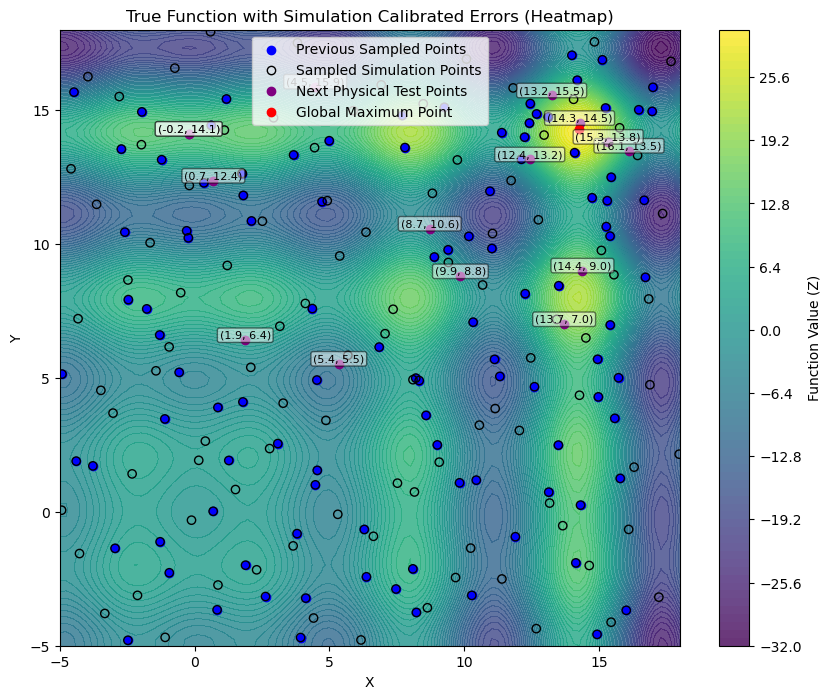

Selected 15 new test points. Median diff: -0.2330
[Iteration 6] RMSE: 1.6474, R²: 0.9688

=== Running with 20 physical experiments ===
[ 2.3863031  -3.24339548]


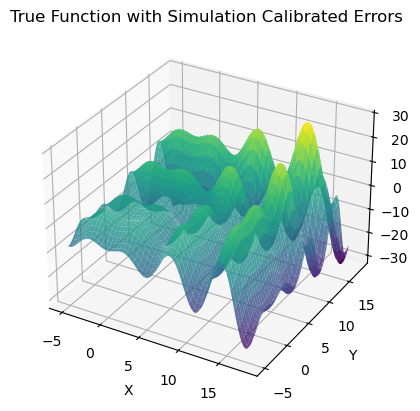

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 112.9447
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 112.5638
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 111.8865
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 111.2048
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 110.5156
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 109.9696
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 109.6359
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 108.6977
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 107.5016
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 107.6403
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 106.5757
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 104.7638
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 104.0273
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 104.5506
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 

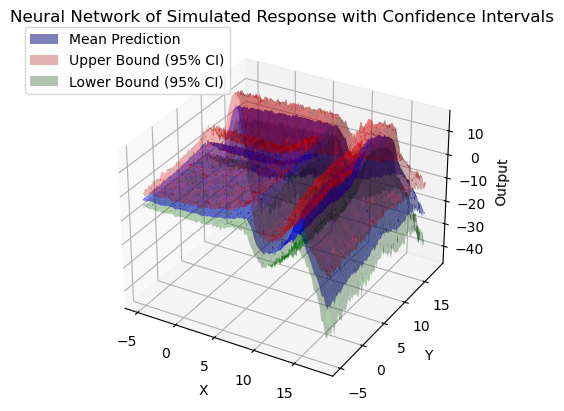

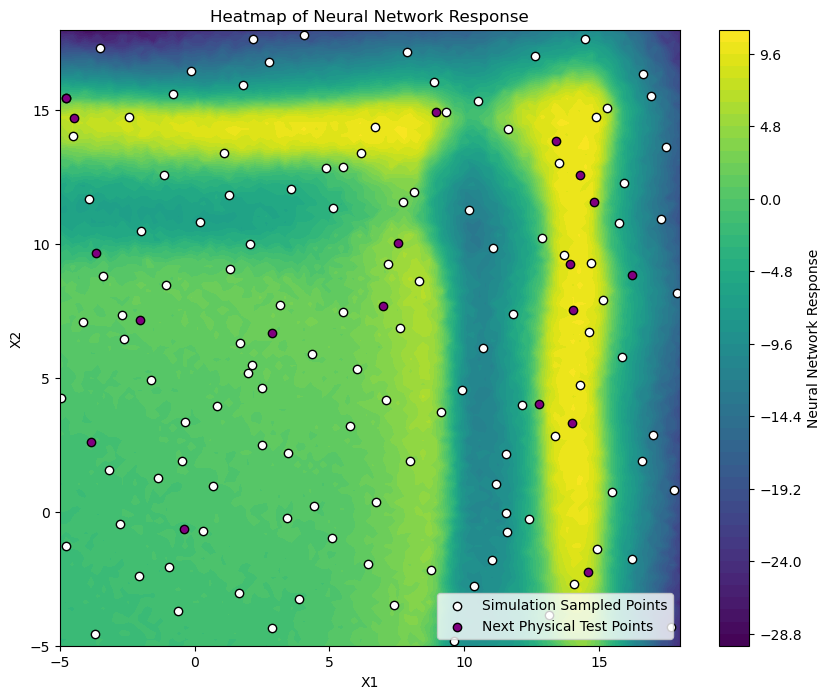

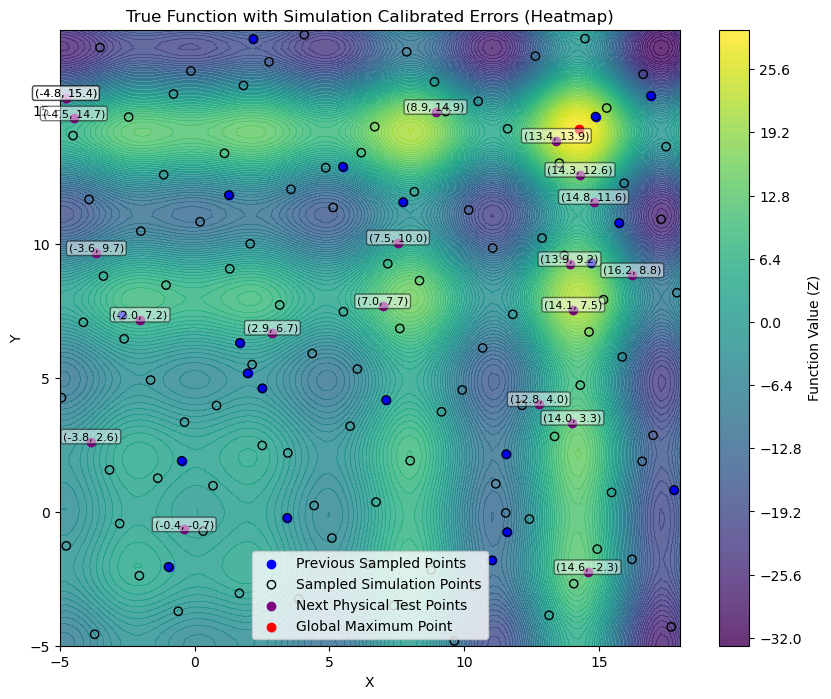

Selected 20 new test points. Median diff: 0.2320
[Iteration 0] RMSE: 1.7379, R²: 0.9694
[ 1.9154881  -3.11994299]


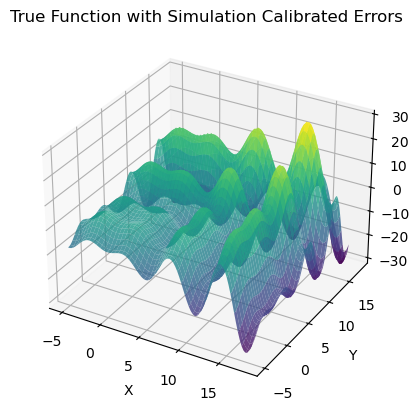

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 440.9669
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 440.0452
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 437.1785
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 434.5436
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 431.5839
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 429.1309
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 424.0509
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 419.4664
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 415.0071
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 401.7700
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 388.3712
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 377.4406
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 380.4860
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 358.1442
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 

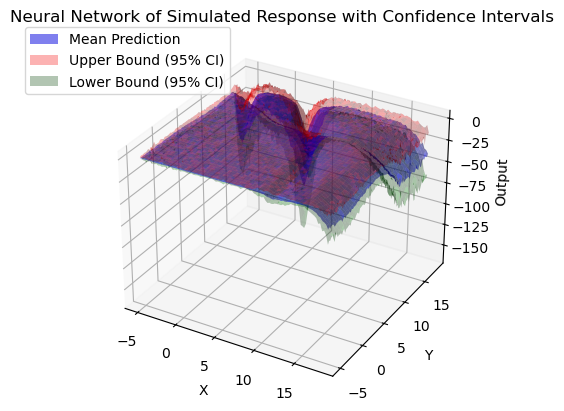

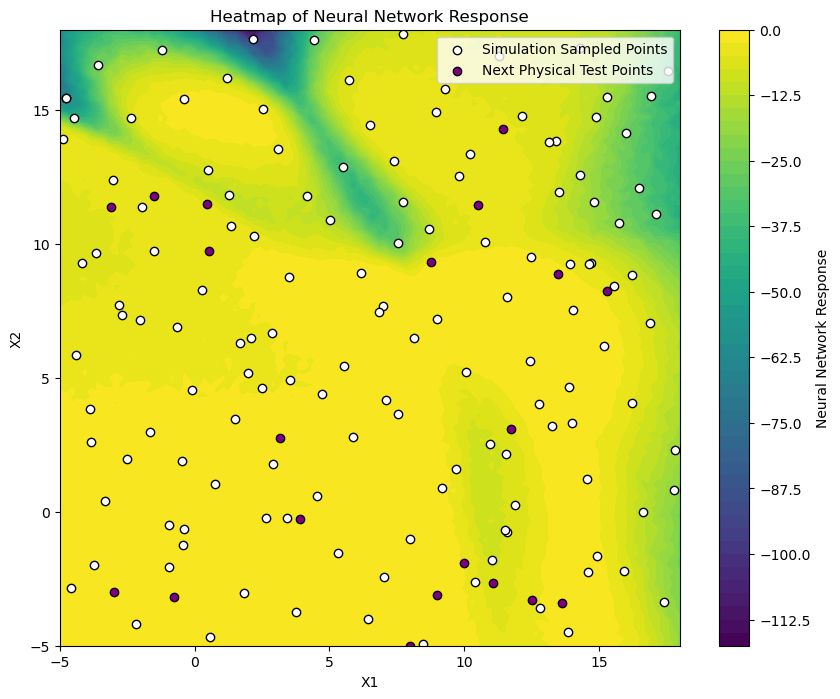

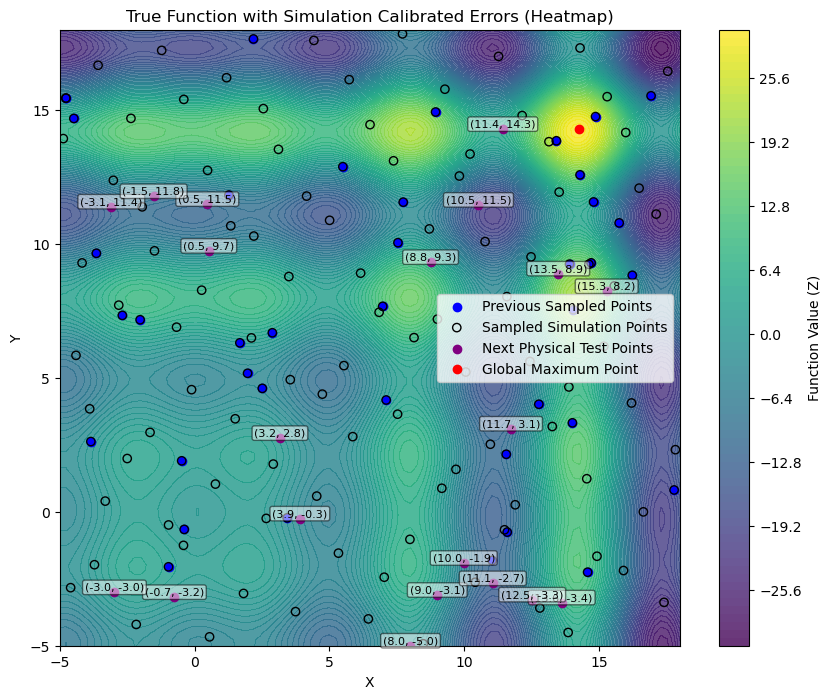

Selected 20 new test points. Median diff: 0.8201
[Iteration 1] RMSE: 29.4797, R²: -8.4360
[ 2.41939429 -3.18740822]


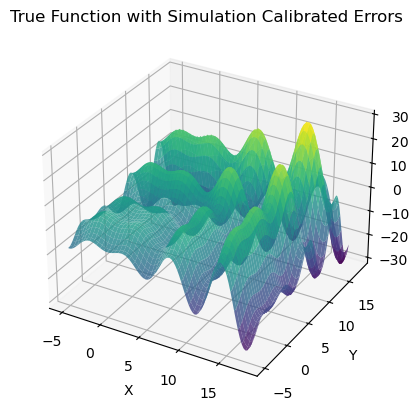

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 142.0043
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 139.5420 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 138.8675 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 140.8820 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 140.0539 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 136.9777 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 137.3066 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 137.9241 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 138.8323 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 138.4295 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 139.8075 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 136.7849 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 137.3506 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 138.3649 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 

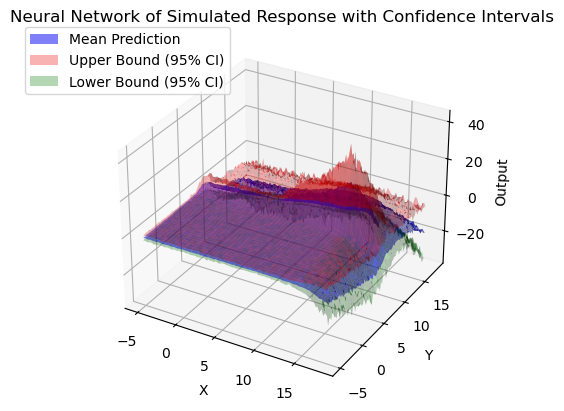

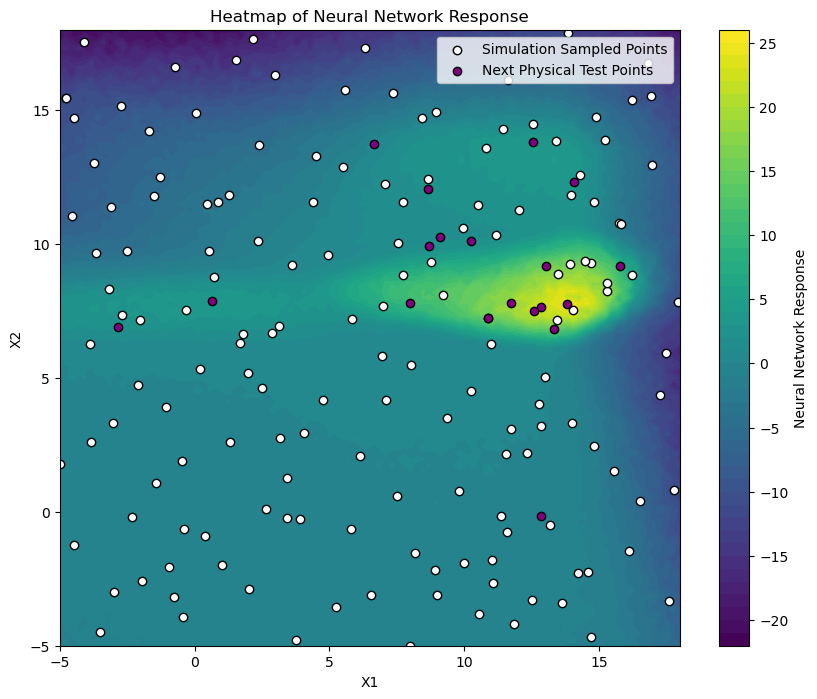

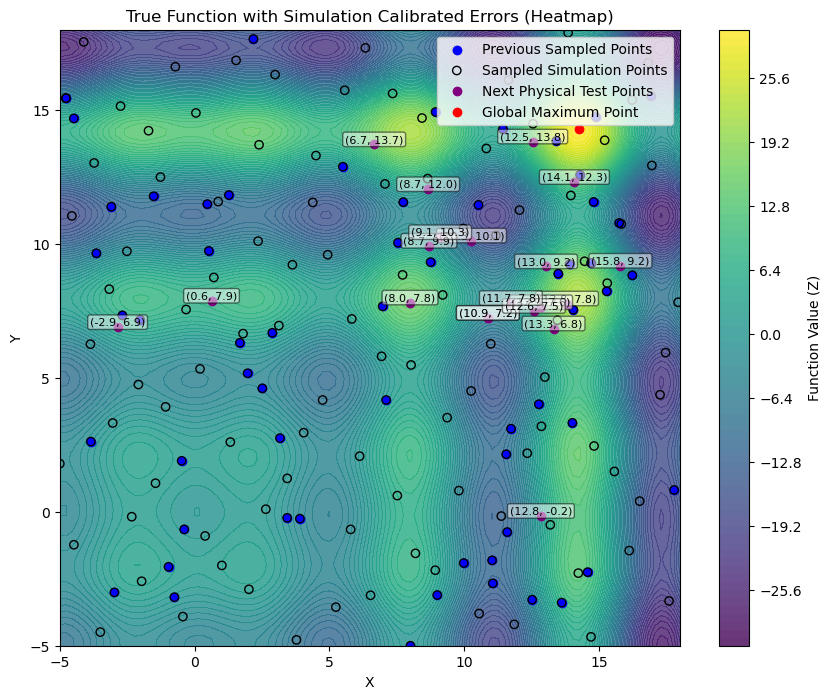

Selected 20 new test points. Median diff: -0.2598
[Iteration 2] RMSE: 4.8037, R²: 0.7430
[ 2.24637313 -3.14742519]


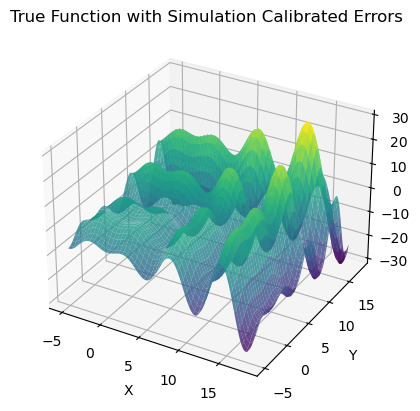

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 482.1416
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 504.5447 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 503.2480 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 497.0904 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 471.4497 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 455.6129 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 435.2856 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 389.0259 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 392.3879 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 360.0191 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 343.8864 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 360.7649 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 319.7884 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 351.7402 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 

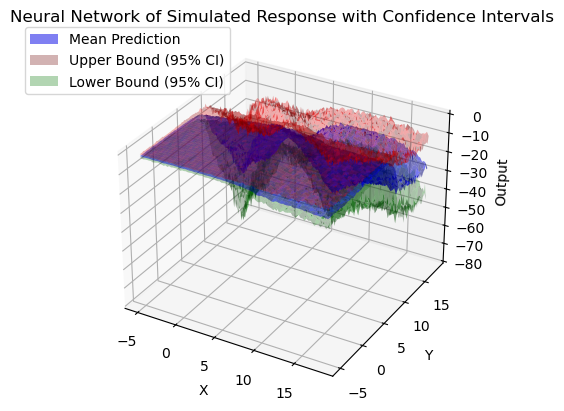

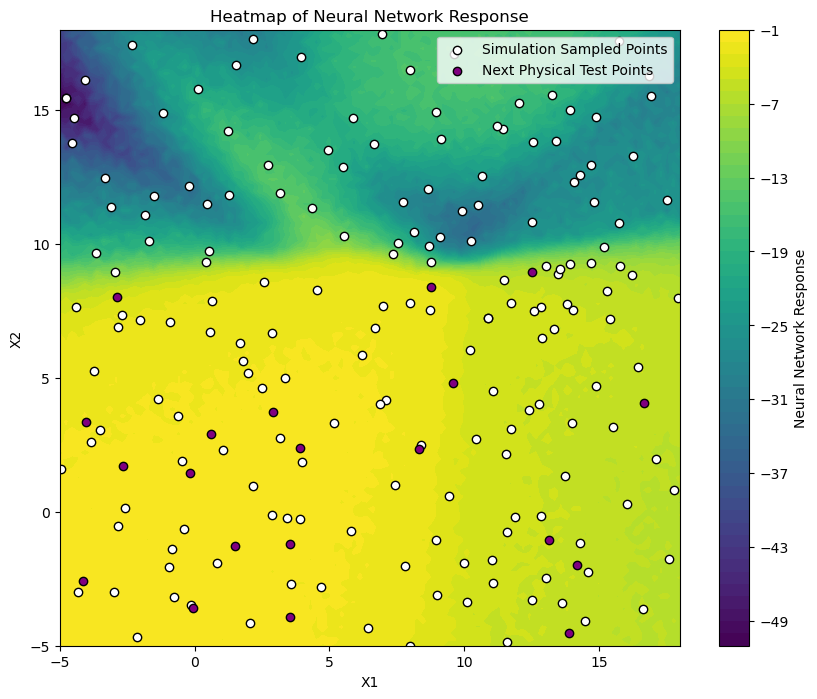

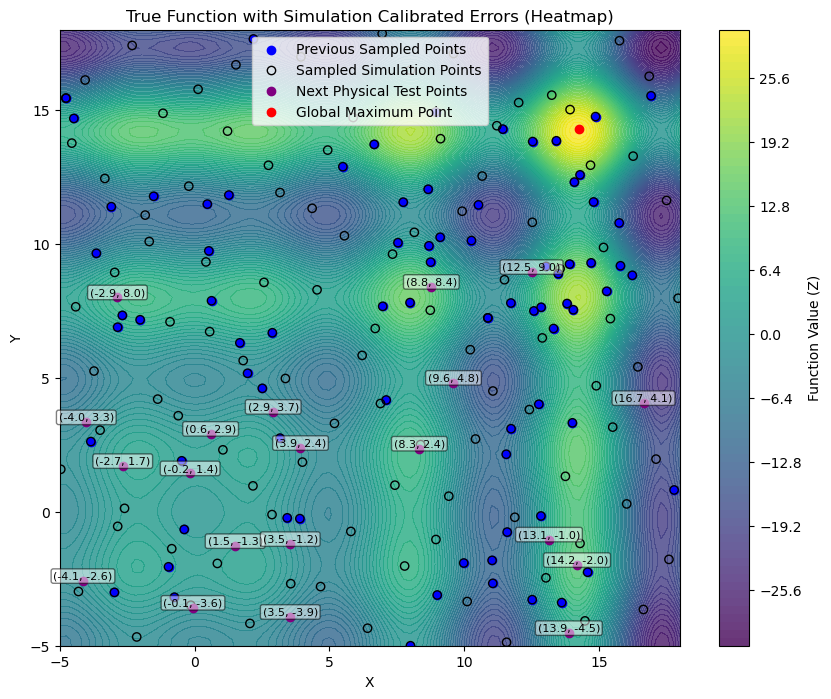

Selected 20 new test points. Median diff: 0.3972
[Iteration 3] RMSE: 28.0600, R²: -8.5757
[ 2.63226794 -3.221313  ]


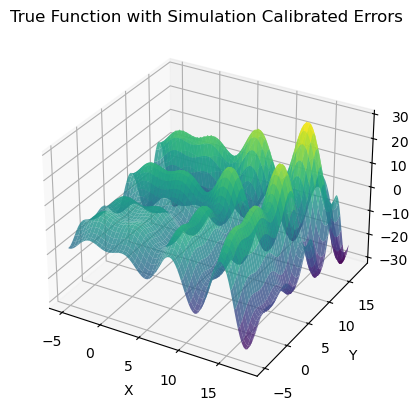

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 2043.8031
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2089.1050 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2111.5291 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2067.1274 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1975.1987 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1975.2722 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1733.2173 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1759.6982 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1777.4083 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1611.8958 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1382.3878 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1542.4027 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1426.0850 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1420.9575 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6m

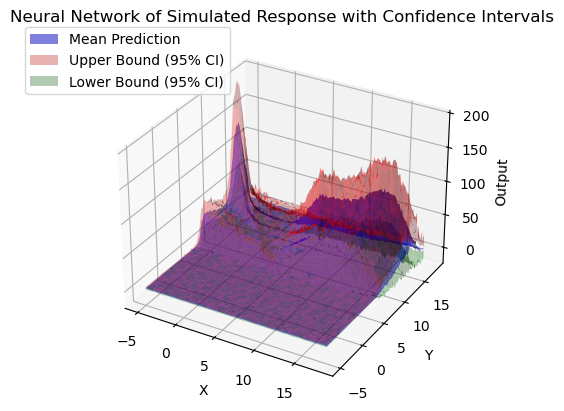

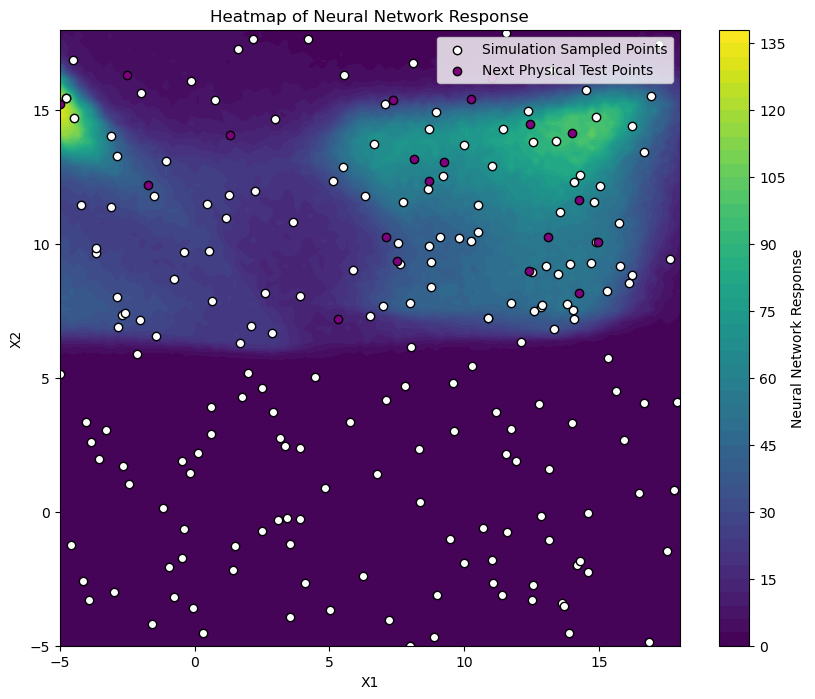

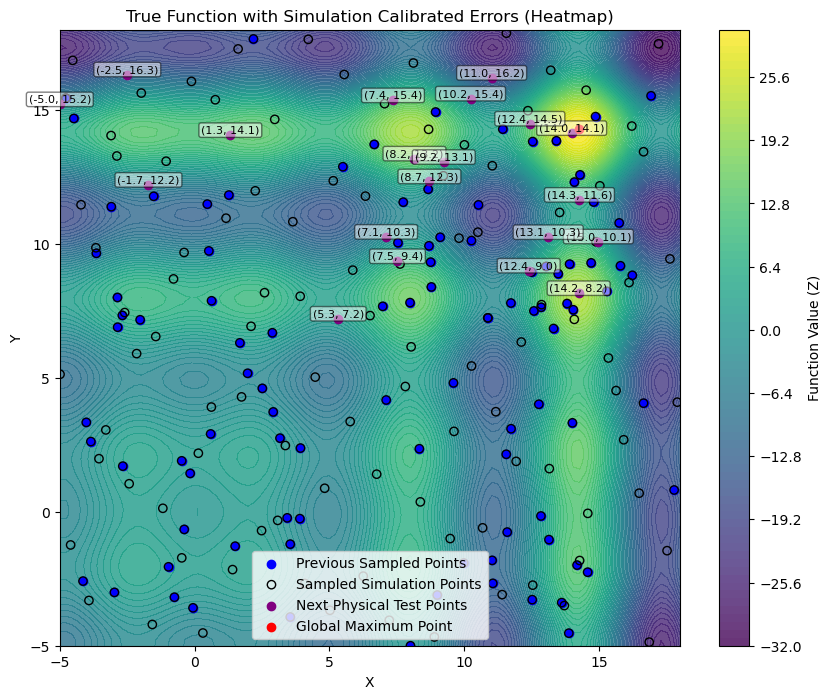

Selected 20 new test points. Median diff: -0.4022
[Iteration 4] RMSE: 56.1812, R²: -35.1418
[ 2.54785185 -3.1860401 ]


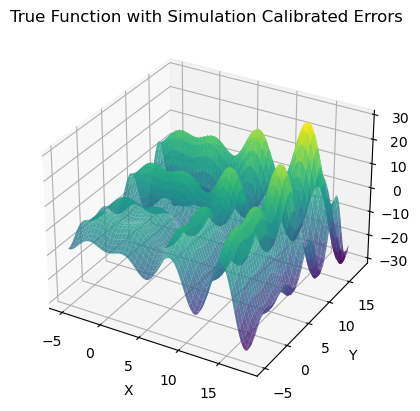

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 110.8970
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 110.0249 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 113.7983 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 107.6262 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 110.4416 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 111.3106 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 110.5493 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 111.8246 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 109.5588 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 111.9137 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 111.2098 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 106.8170 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 106.5175 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 108.3470 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 

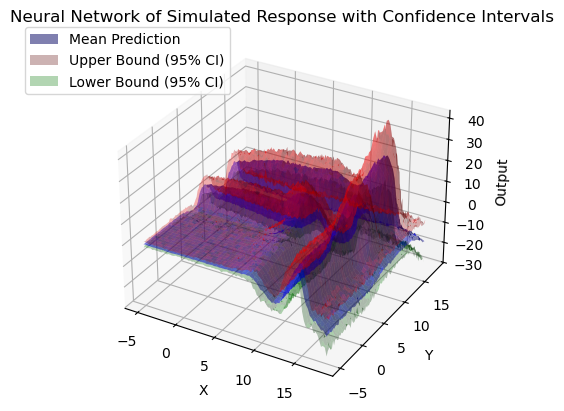

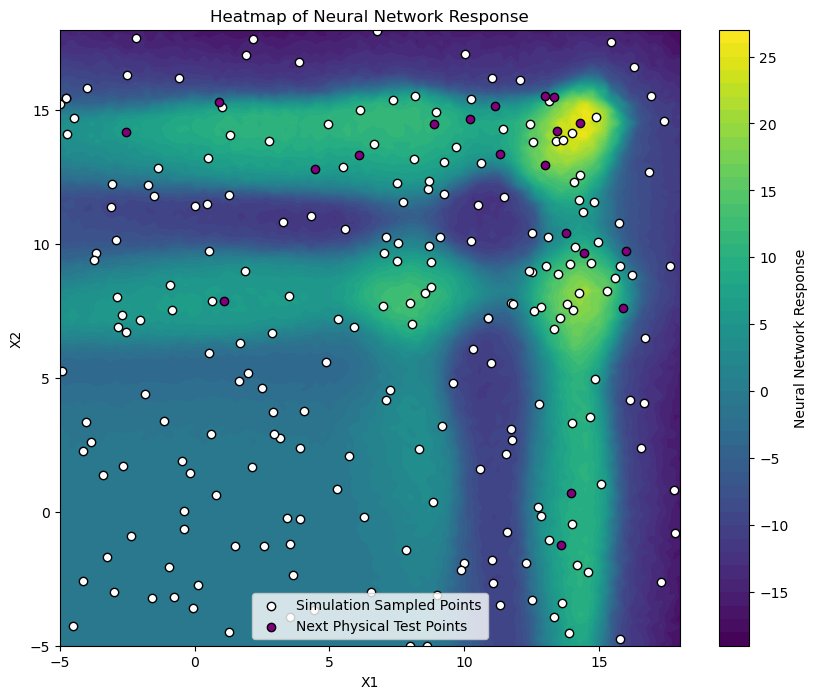

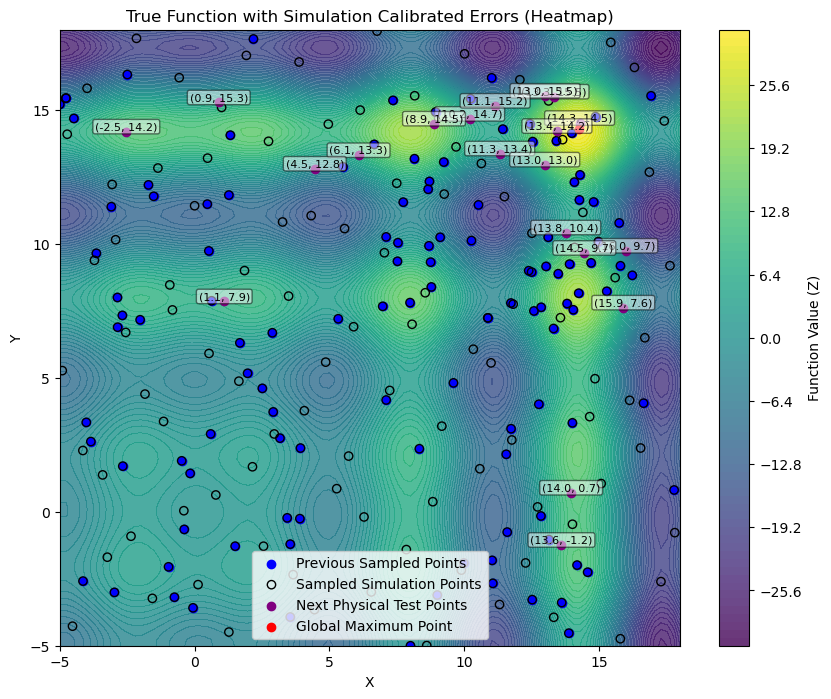

Selected 20 new test points. Median diff: -1.0853
[Iteration 5] RMSE: 1.5212, R²: 0.9744
[ 2.34266605 -3.19886238]


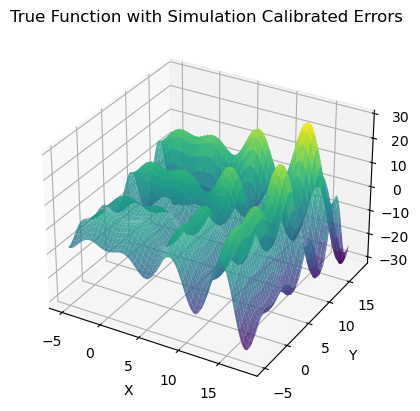

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 2787.3528
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 2681.8589 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2748.7410 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 2728.4666 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2766.6292 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 2721.3499 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 2409.9314 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 2183.7876 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2080.0967 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 1687.1558 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1531.7312 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 1682.5085 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 1559.5063 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 1338.6342 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8m

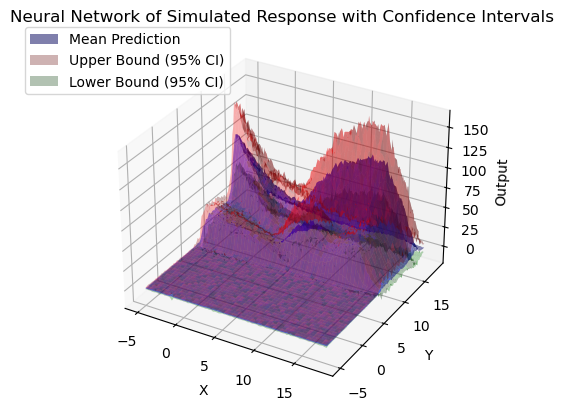

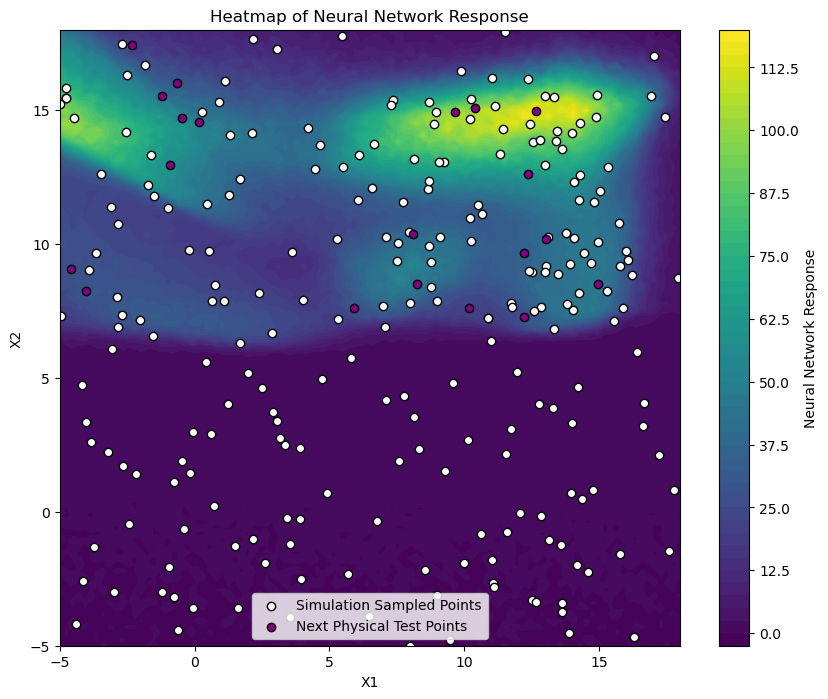

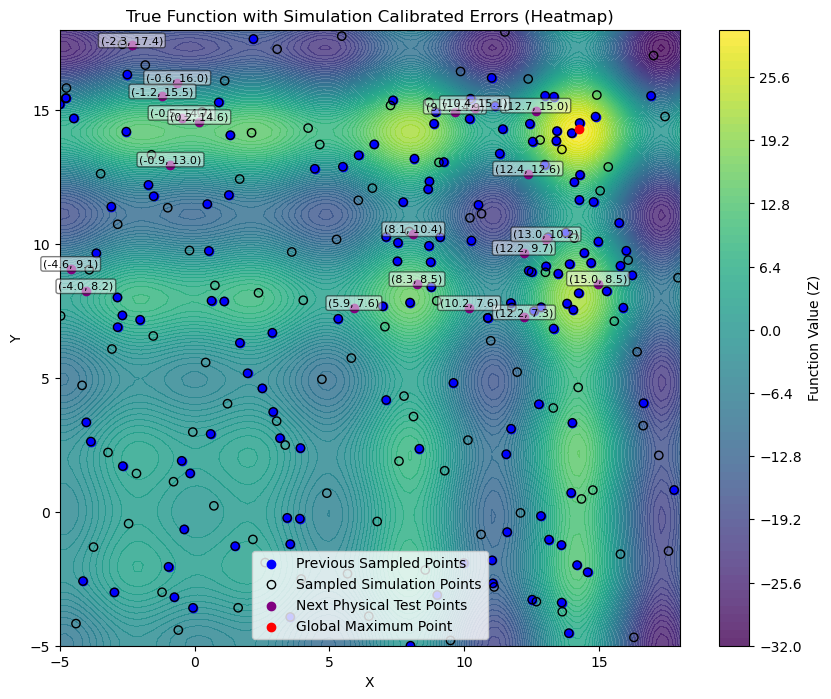

Selected 20 new test points. Median diff: -0.0630
[Iteration 6] RMSE: 60.3402, R²: -41.0840

=== Running with 25 physical experiments ===
[ 2.13587436 -3.17890105]


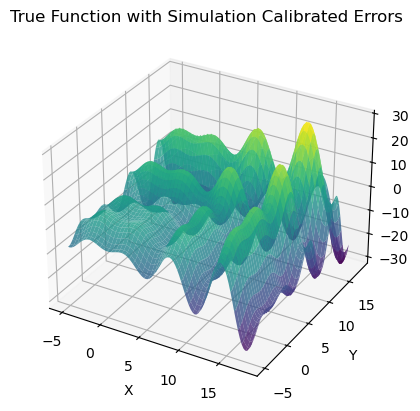

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 118.8047
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 119.0392
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 118.4988
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 117.7608
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 117.5476
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 117.2517
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 116.5471
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 115.9501
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 115.8406
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 114.9149
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 114.9572
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 114.1343
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 113.6211
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 112.6275
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 

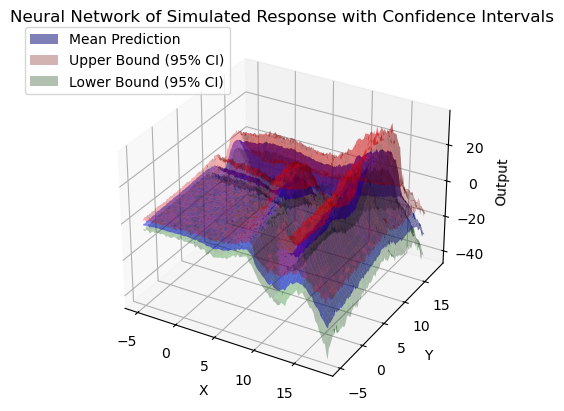

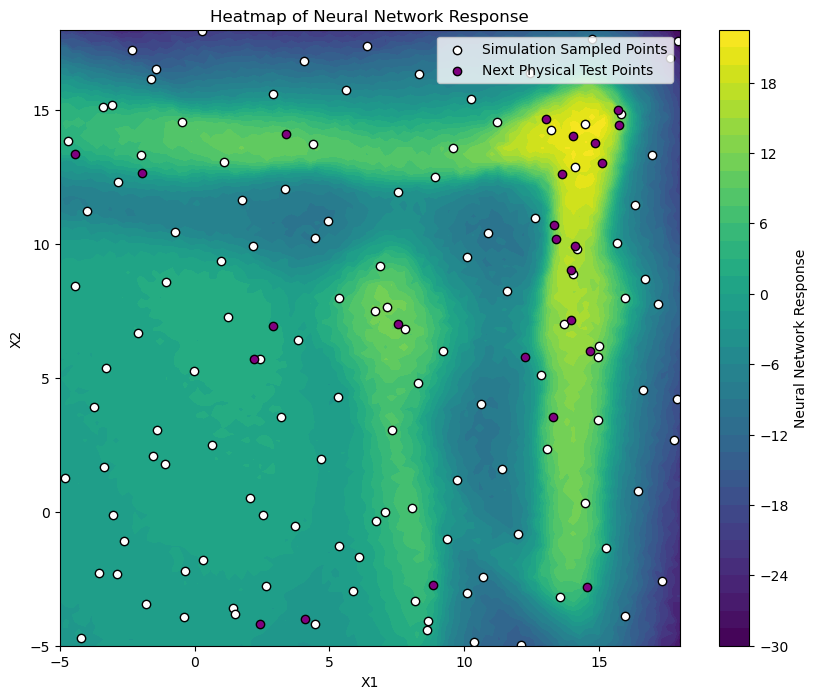

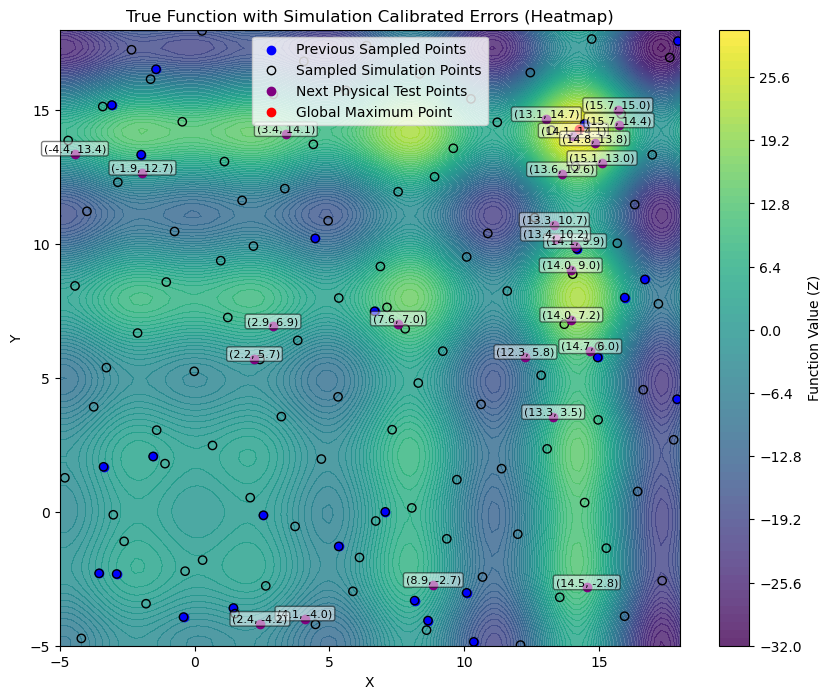

Selected 25 new test points. Median diff: 0.2159
[Iteration 0] RMSE: 3.3217, R²: 0.9094
[ 2.25998611 -3.18810369]


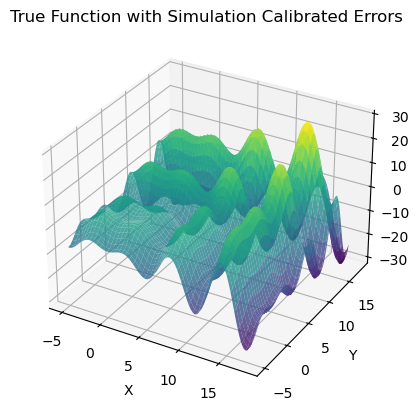

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 1131.4644
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 1128.6061
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 1125.5814
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 1121.3386
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 1118.1245
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 1108.4718
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 1100.4099
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 1092.1945
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 1075.0642
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 1059.2629
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 1035.0929
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 1017.6555
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 982.1703
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 943.1169
Epoch 15/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/s

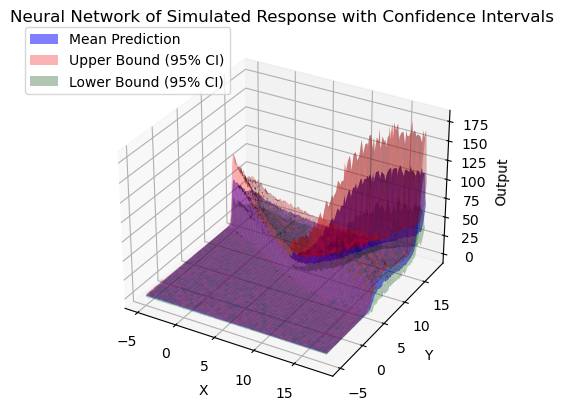

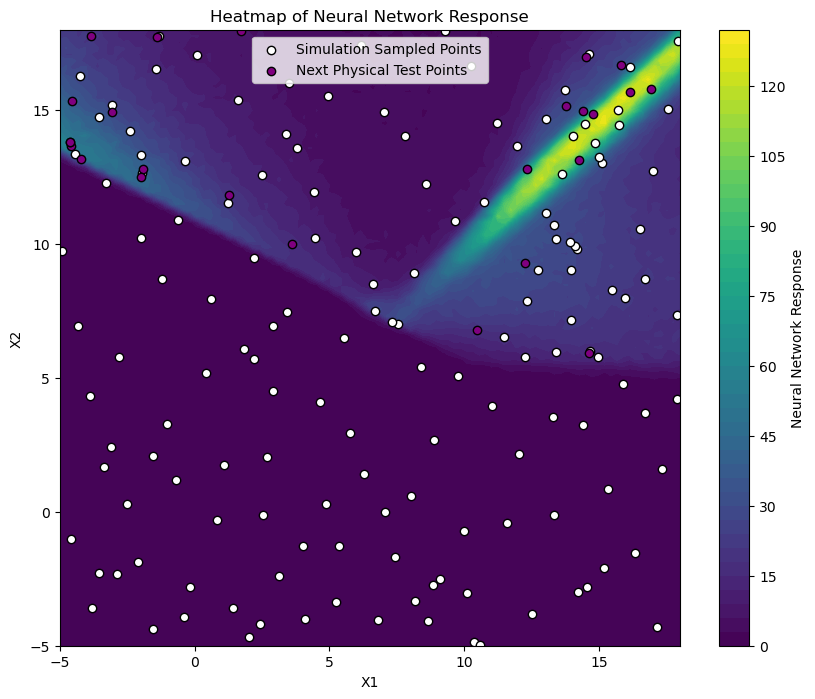

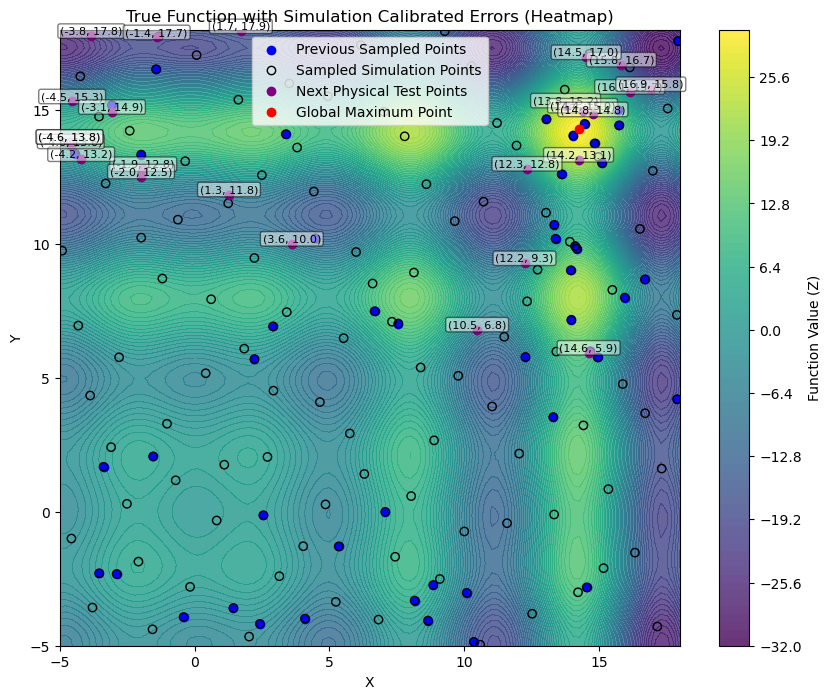

Selected 25 new test points. Median diff: 0.5384
[Iteration 1] RMSE: 40.9758, R²: -11.5048
[ 1.49062376 -3.09336448]


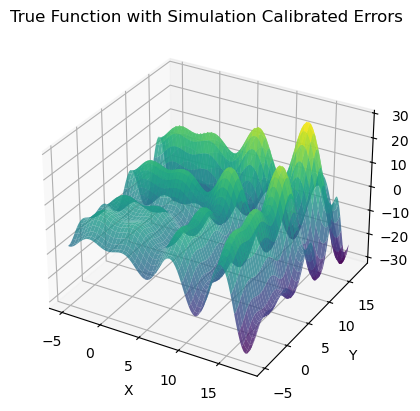

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - loss: 140.0880
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 137.9879 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 134.7901 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 138.2704 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 133.9261 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 132.7540 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 134.5224 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 137.6674 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 131.4670 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 135.3390 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 137.4023 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 135.8638 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 131.5645 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 133.8297 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss:

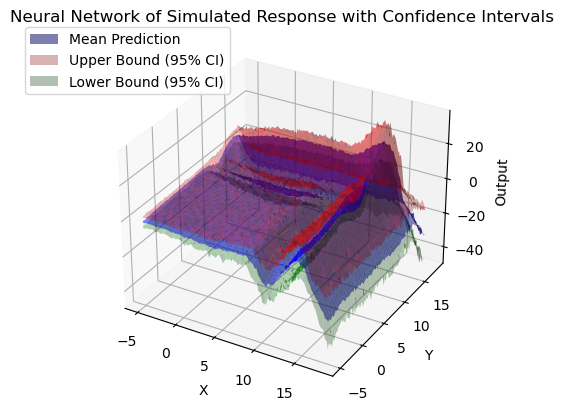

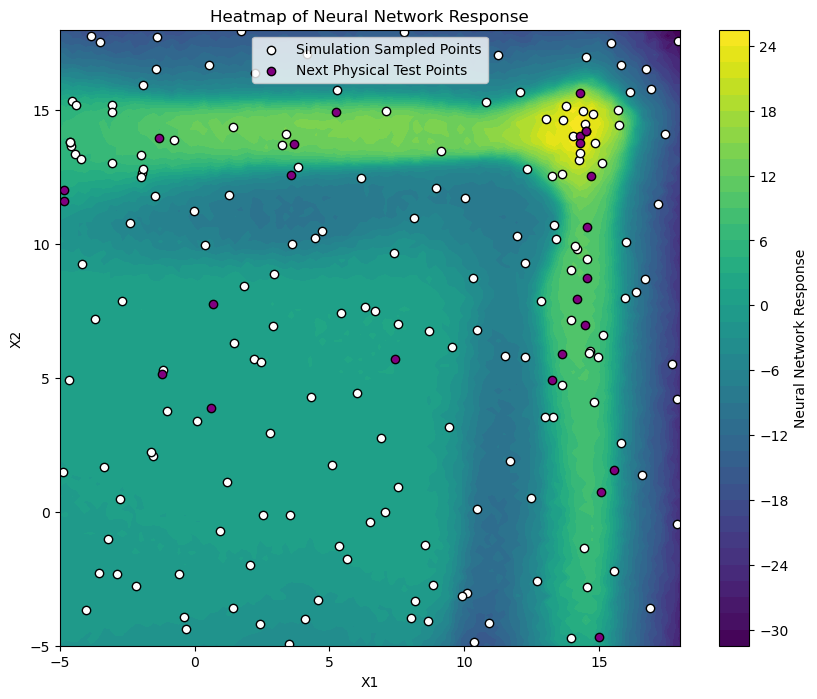

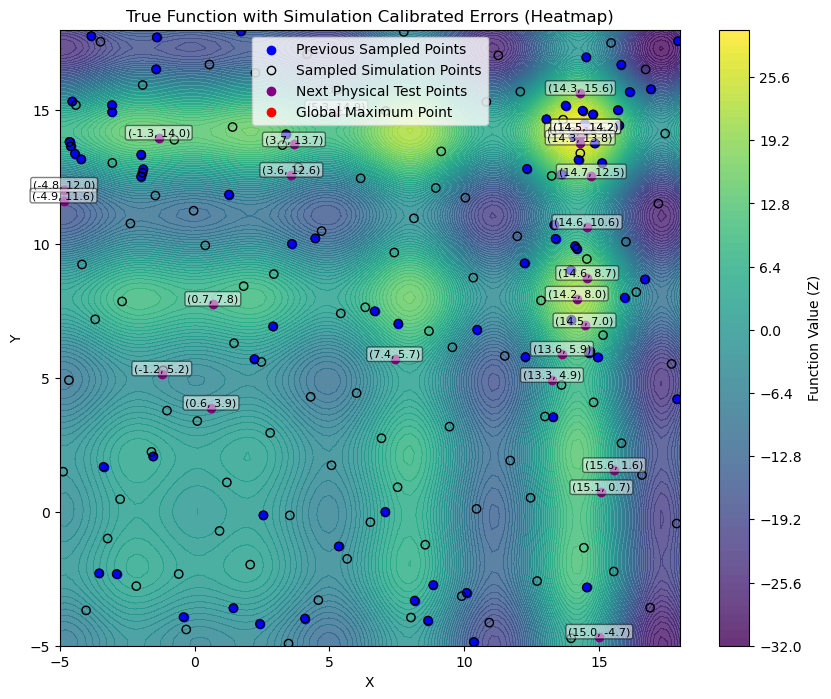

Selected 25 new test points. Median diff: 0.2621
[Iteration 2] RMSE: 1.9878, R²: 0.9719
[ 1.55547468 -3.11495305]


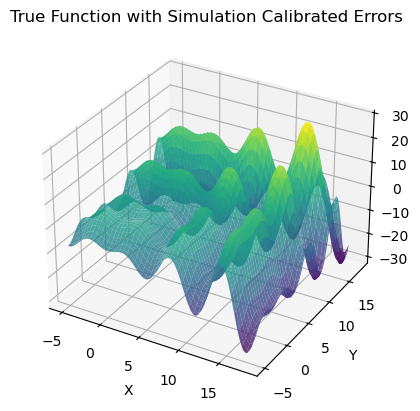

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - loss: 150.1464
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 150.2313
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 153.6634 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 147.0728 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 154.2813 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 151.7673 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 156.0346 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 143.8308 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 149.6272 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 149.5128 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 144.1091 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 147.6458 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 148.3135 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 151.4238 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss:

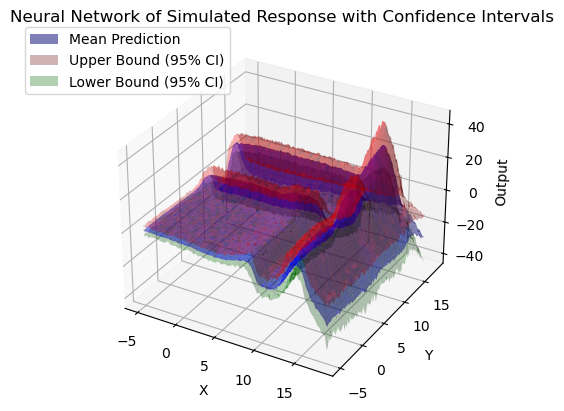

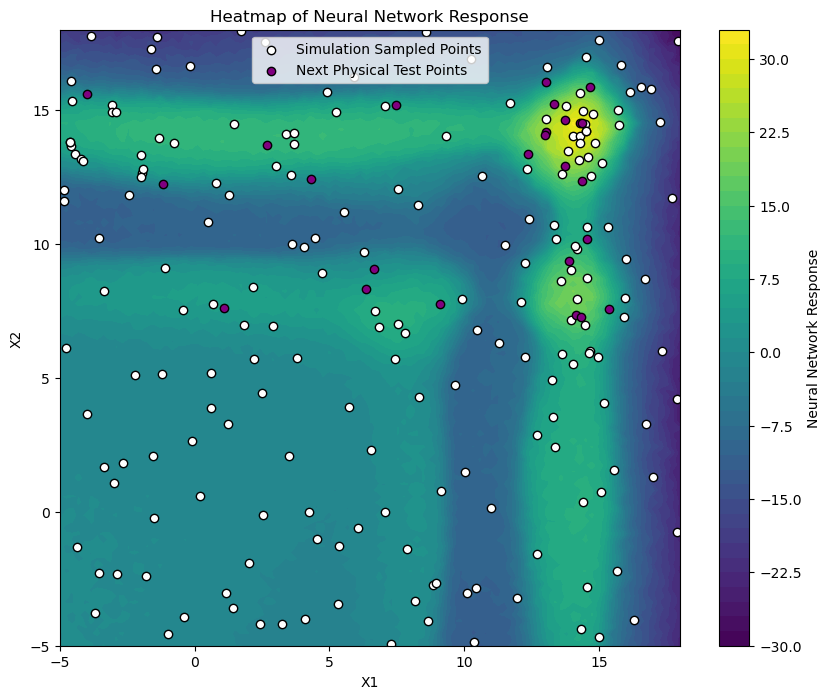

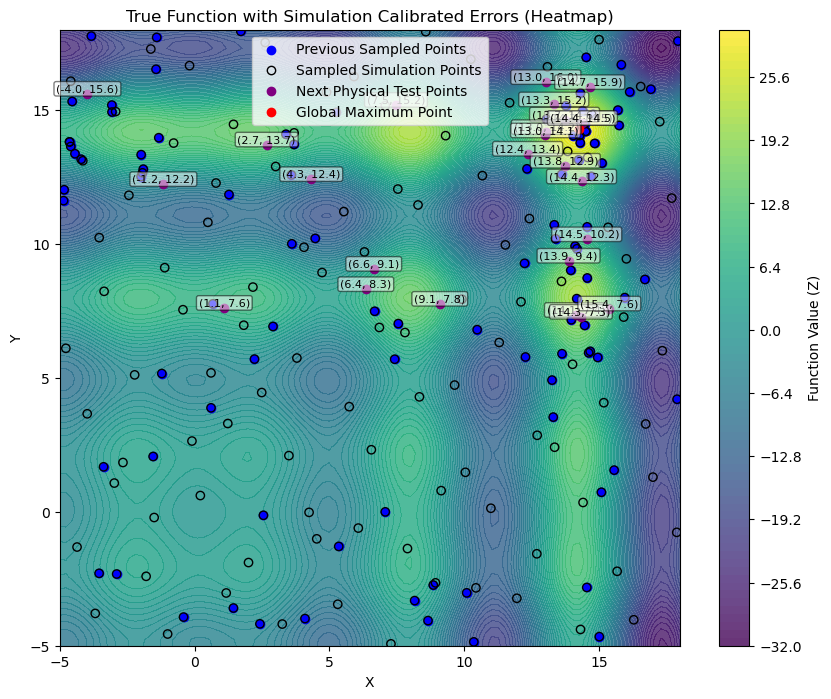

Selected 25 new test points. Median diff: -0.2030
[Iteration 3] RMSE: 1.6437, R²: 0.9802
[ 1.34149167 -3.12053671]


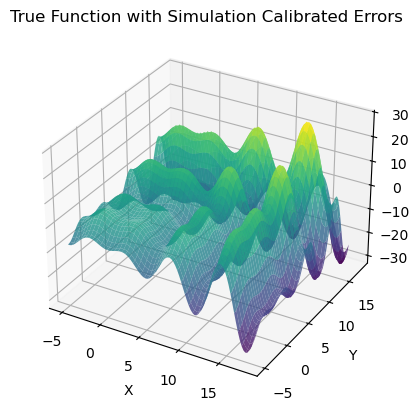

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 152.1233
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 154.7226 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 150.3213 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 154.1261 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 148.3777 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 151.1003 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 146.2495 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 148.3330 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 151.0027 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 151.5355 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 146.4701 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 138.9663 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 147.0179 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 144.6227 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 

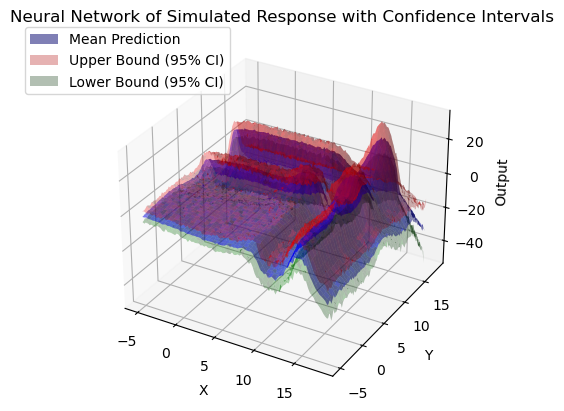

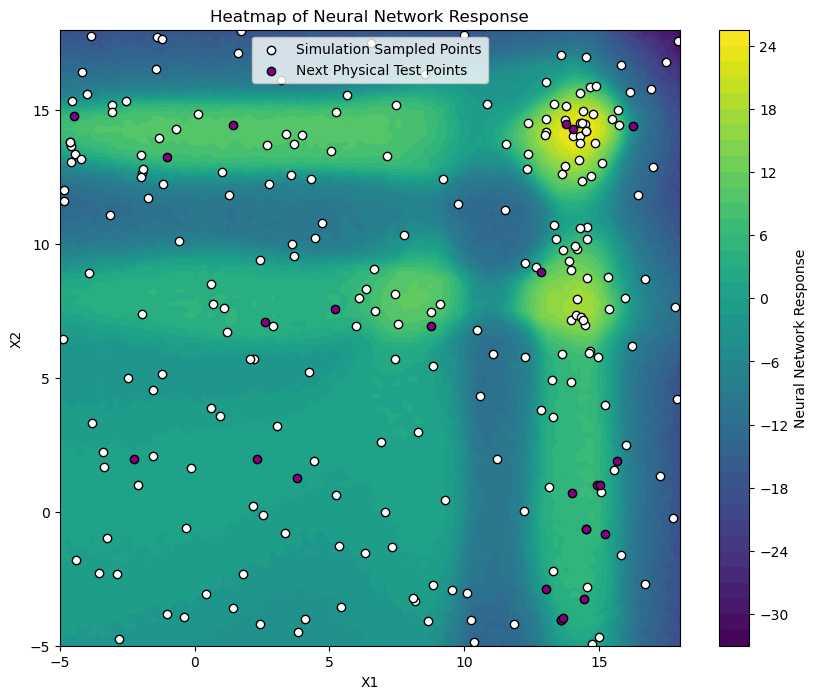

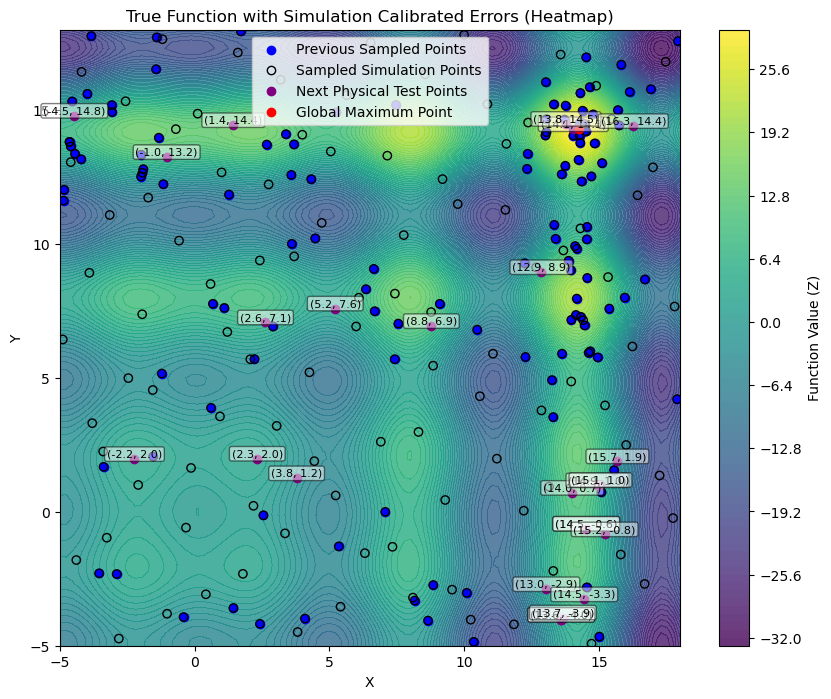

Selected 25 new test points. Median diff: 2.2191
[Iteration 4] RMSE: 2.1146, R²: 0.9635
[ 1.75628246 -3.12930062]


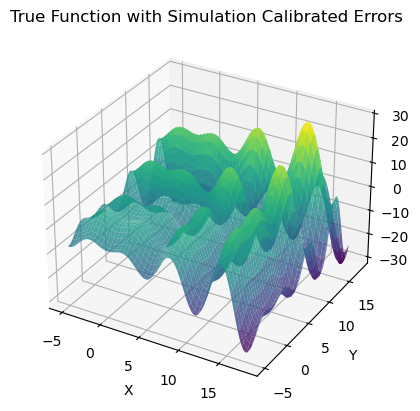

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - loss: 148.0124
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 152.6777 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 144.7063 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 149.3761 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 139.3134 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 149.6015 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 143.7874 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 143.1889 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 142.4887 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 133.7800 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 133.2300 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 130.6484 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 133.5511 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 125.7346 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss:

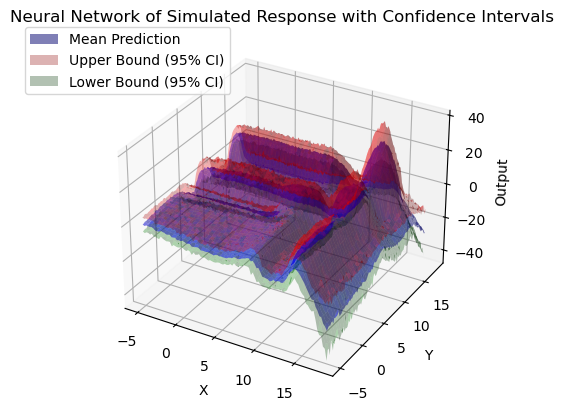

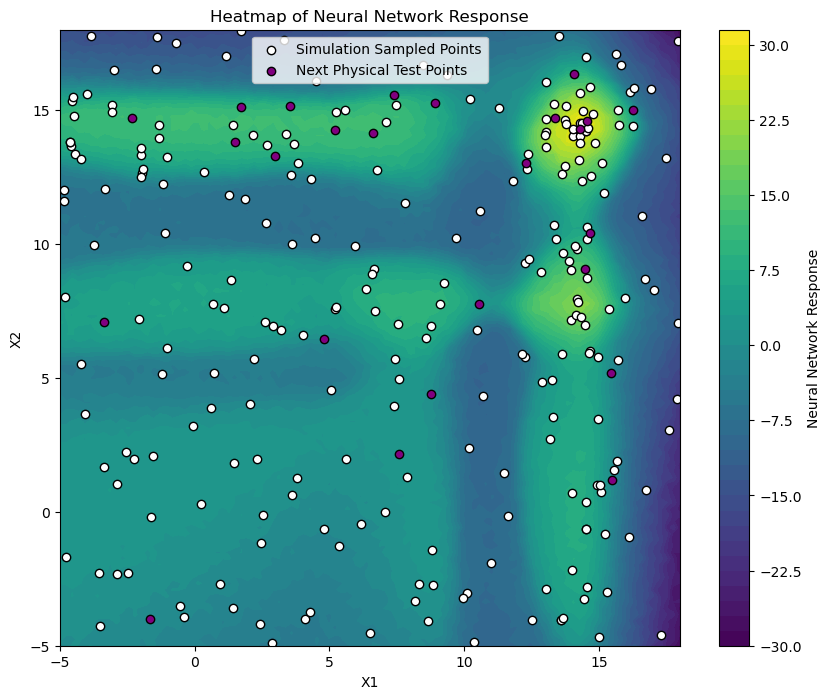

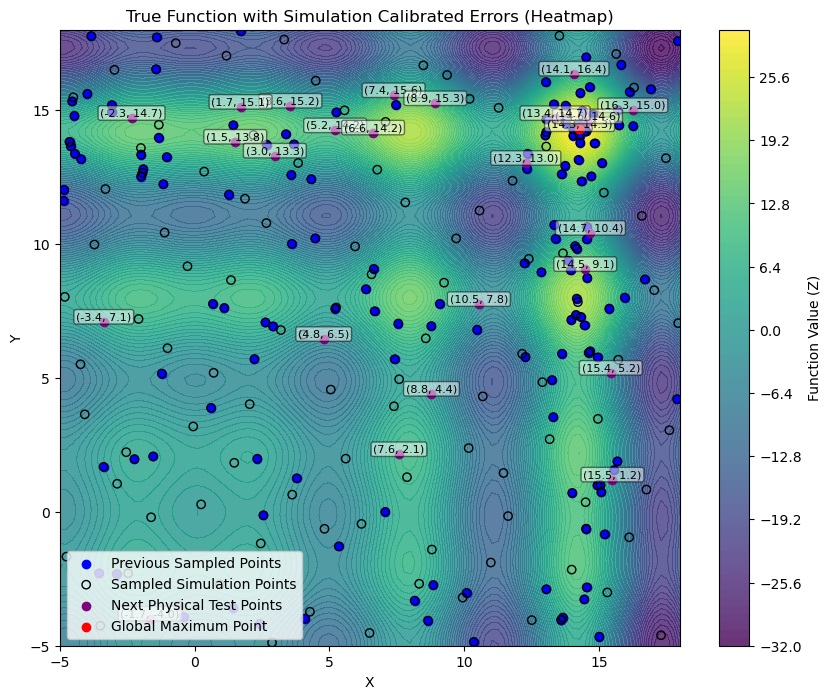

Selected 25 new test points. Median diff: 0.2298
[Iteration 5] RMSE: 2.3104, R²: 0.9538
[ 1.83054072 -3.1604342 ]


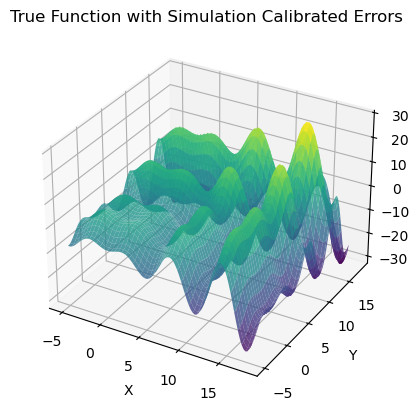

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 149.2471
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 159.7999 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 158.9750 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 150.2471 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 162.3741 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 149.9001 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 145.8464
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 144.4396 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 139.3783 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 133.8856 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 131.4323 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 125.4274 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 137.8444 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 129.1207 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 

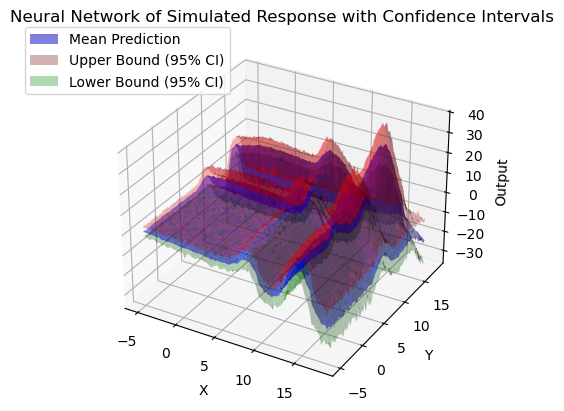

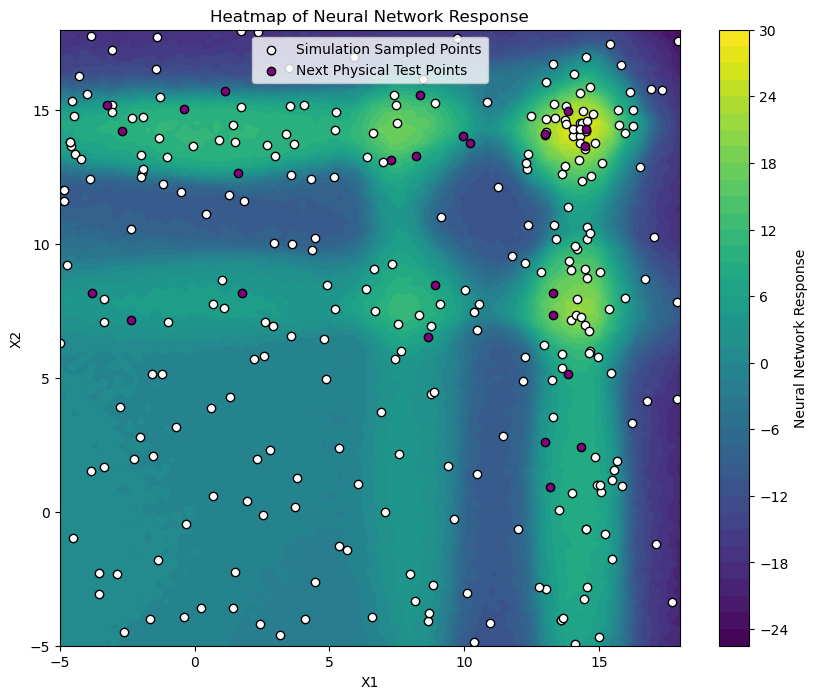

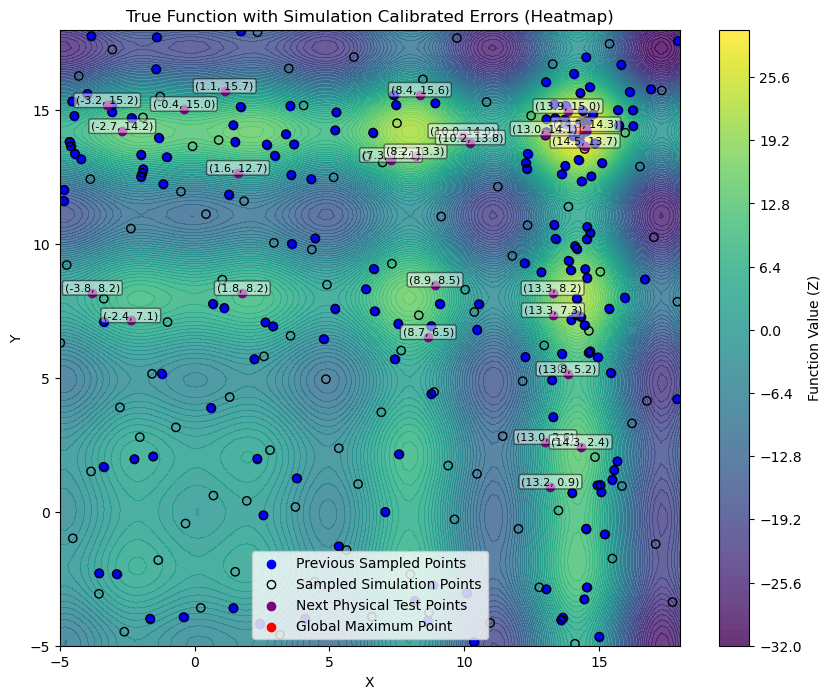

Selected 25 new test points. Median diff: 0.4173
[Iteration 6] RMSE: 1.7677, R²: 0.9714


In [43]:
from sklearn.metrics import mean_squared_error, r2_score

for exp_count in experiment_counts:
    print(f"\n=== Running with {exp_count} physical experiments ===")

    # Initialize your df with some starting data (maybe LHS or manual)
    df = initialize_df(n=exp_count)  # You define this function

    # For tracking RMSE, R2 over time
    rmse_list = []
    r2_list = []
    iteration_list = []

    for iteration in range(n_iterations_per_run):
        df = perform_iteration(
            df,
            iteration=iteration,
            rmse_list=rmse_list,
            r2_list=r2_list,
            iteration_list=iteration_list,
            exp_n=exp_count
        )

        # Compute final metrics for this iteration
        rmse = mean_squared_error(df["z"], df["sim_z"], squared=False)
        r2 = r2_score(df["z"], df["sim_z"])
        best_z = df["z"].max()

        log_metrics(exp_count, iteration, rmse, r2, best_z)

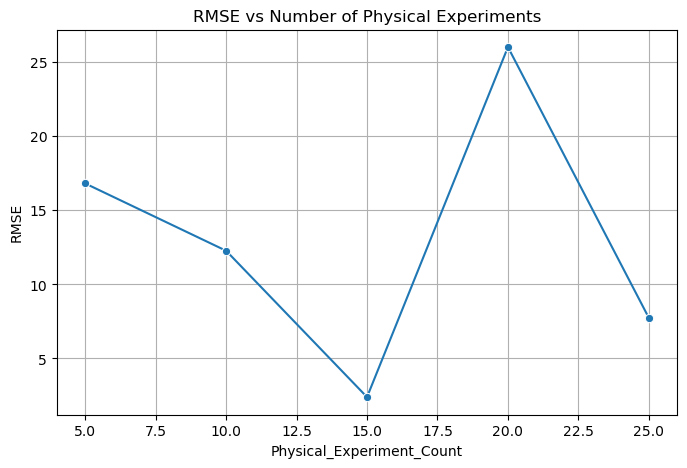

In [47]:
metrics_df = pd.DataFrame(results)

# Save to CSV
metrics_df.to_csv("experiment_metrics_summary2.csv", index=False)

# Plot example: RMSE vs Physical Experiment Count
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
sns.lineplot(data=metrics_df, x="Physical_Experiment_Count", y="RMSE", ci=None, marker='o')
plt.title("RMSE vs Number of Physical Experiments")
plt.grid(True)
plt.show()

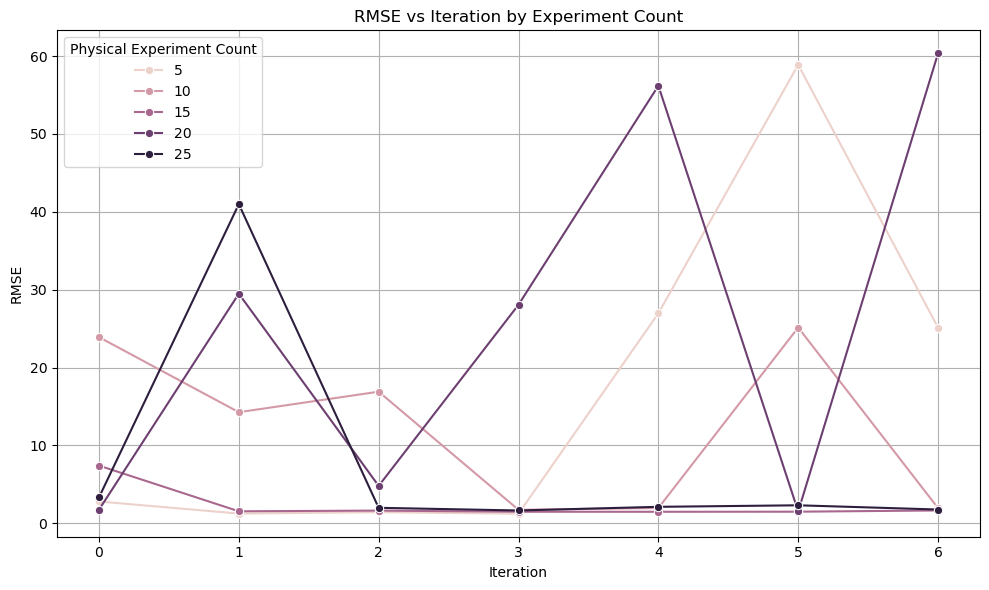

In [52]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))

sns.lineplot(
    data=metrics_df,
    x="Iteration",
    y="RMSE",
    hue="Physical_Experiment_Count",
    marker="o"
)

plt.title("RMSE vs Iteration by Experiment Count")
plt.xlabel("Iteration")
plt.ylabel("RMSE")
plt.legend(title="Physical Experiment Count")
plt.grid(True)
plt.tight_layout()
plt.show()

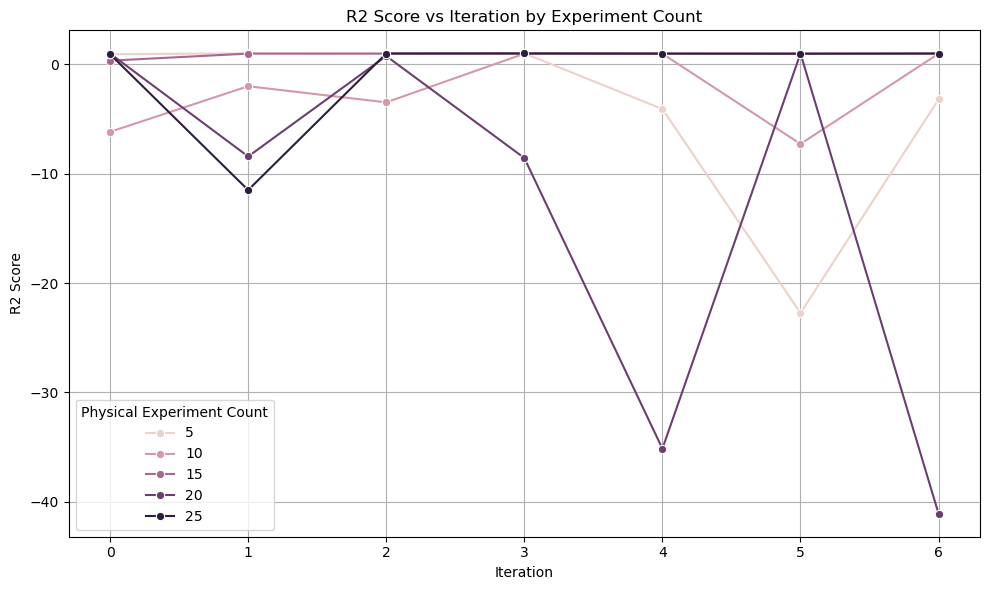

In [57]:
plt.figure(figsize=(10, 6))

sns.lineplot(
    data=metrics_df,
    x="Iteration",
    y="R2",
    hue="Physical_Experiment_Count",
    marker="o"
)

plt.title("R2 Score vs Iteration by Experiment Count")
plt.xlabel("Iteration")
plt.ylabel("R2 Score")
plt.legend(title="Physical Experiment Count")
plt.grid(True)
plt.tight_layout()
plt.show()

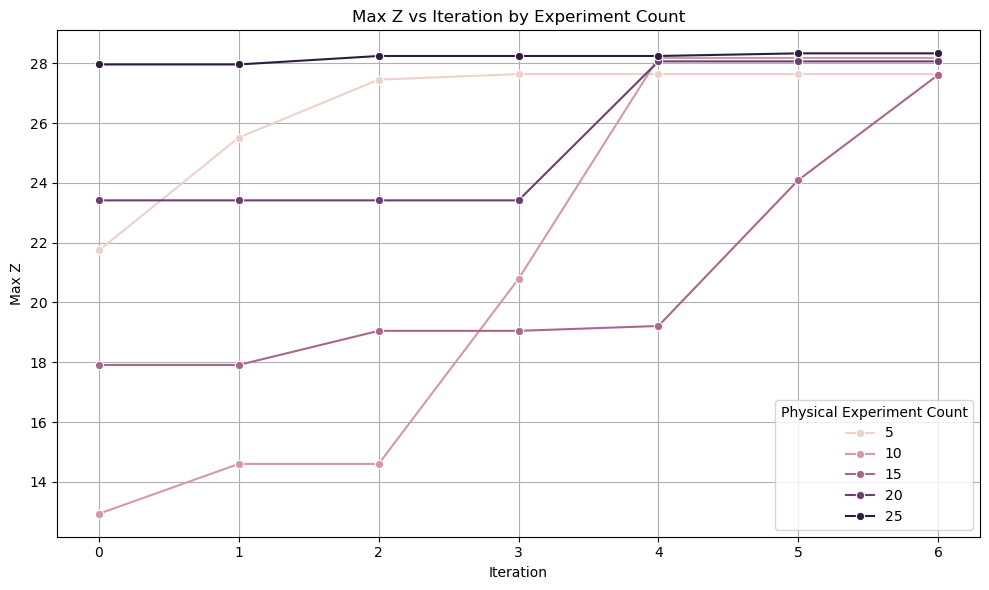

In [58]:
plt.figure(figsize=(10, 6))

sns.lineplot(
    data=metrics_df,
    x="Iteration",
    y="Best_Z",
    hue="Physical_Experiment_Count",
    marker="o"
)

plt.title("Max Z vs Iteration by Experiment Count")
plt.xlabel("Iteration")
plt.ylabel("Max Z")
plt.legend(title="Physical Experiment Count")
plt.grid(True)
plt.tight_layout()
plt.show()

In [62]:
df_median = pd.read_excel('Median_metrics.xlsx')

In [65]:
df_median.head()

,Physical_Experiment_Count,Iterations,Median
0,5,0,-2.8947
1,5,1,-0.5749
2,5,2,0.1081
3,5,3,-0.0868
4,5,4,0.7408


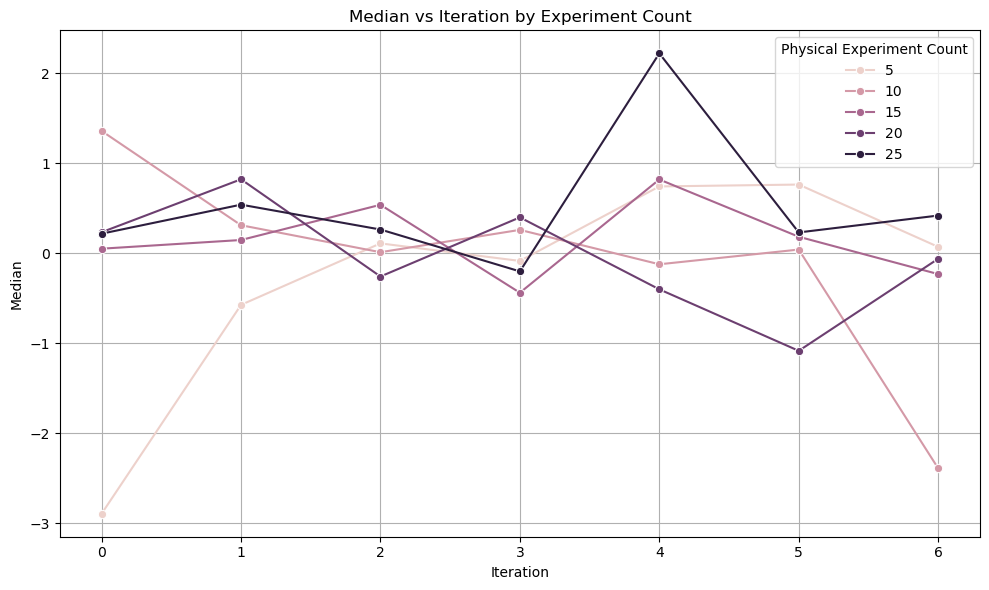

In [68]:
plt.figure(figsize=(10, 6))

sns.lineplot(
    data=df_median,
    x="Iterations",
    y="Median",
    hue="Physical_Experiment_Count",
    marker="o"
)

plt.title("Median vs Iteration by Experiment Count")
plt.xlabel("Iteration")
plt.ylabel("Median")
plt.legend(title="Physical Experiment Count")
plt.grid(True)
plt.tight_layout()
plt.show()

In [61]:
global_maxima_df

,X,Y,Z
0,14.28,14.28,28.269165


In [48]:
metrics_df

,Physical_Experiment_Count,Iteration,RMSE,R2,Best_Z
0,5,0,2.798534,0.914889,21.743194
1,5,1,1.248071,0.985961,25.515906
2,5,2,1.423285,0.982752,27.451533
3,5,3,1.230869,0.987711,27.637667
4,5,4,26.957054,-4.097169,27.637667
5,5,5,58.874916,-22.747205,27.637667
6,5,6,25.124345,-3.218640,27.637667
7,10,0,23.902735,-6.184414,12.935855
8,10,1,14.263134,-2.016784,14.600780
9,10,2,16.897692,-3.490192,14.600780


In [49]:
df

,x,y,z,a,b,sim_z,diff
0,4.475834,10.207944,-11.484756,1.830541,-3.160434,-12.133476,0.648720
1,5.347285,-1.292777,-3.059932,1.830541,-3.160434,-4.403655,1.343723
2,17.900429,4.204016,-18.220850,1.830541,-3.160434,-19.825503,1.604654
3,-2.890238,-2.321785,2.445534,1.830541,-3.160434,3.133586,-0.688052
4,-1.981080,13.336062,11.117272,1.830541,-3.160434,8.960808,2.156464
...,...,...,...,...,...,...,...
195,9.960368,14.039431,8.896984,1.830541,-3.160434,9.334672,-0.437687
196,13.202948,0.938642,8.637255,1.830541,-3.160434,6.098450,2.538805
197,10.231895,13.788494,5.634642,1.830541,-3.160434,6.048288,-0.413646
198,8.357399,15.575003,9.399809,1.830541,-3.160434,9.523663,-0.123854


In [60]:
df.head(25)

,x,y,z,a,b,sim_z,diff
0,4.475834,10.207944,-11.484756,1.830541,-3.160434,-12.133476,0.648720
1,5.347285,-1.292777,-3.059932,1.830541,-3.160434,-4.403655,1.343723
2,17.900429,4.204016,-18.220850,1.830541,-3.160434,-19.825503,1.604654
3,-2.890238,-2.321785,2.445534,1.830541,-3.160434,3.133586,-0.688052
4,-1.981080,13.336062,11.117272,1.830541,-3.160434,8.960808,2.156464
5,-3.376616,1.680143,0.945243,1.830541,-3.160434,1.354277,-0.409034
6,8.659617,-4.061187,2.744254,1.830541,-3.160434,-0.243136,2.987390
7,10.093773,-3.025213,-5.901021,1.830541,-3.160434,-9.003384,3.102364
8,15.958016,7.999633,3.969628,1.830541,-3.160434,3.884454,0.085175
9,-1.429416,16.523709,-10.632001,1.830541,-3.160434,-13.707475,3.075474
